**Index:**

* [Problem Statement](#scrollTo=QHXgUY8_82Uw)
* [Section 0: Importing necessary libraries and reusable libraries created](#scrollTo=mLpIi1FcBTAB)
* [Section 1: Importing the dataset and preparing data folders](#scrollTo=FqoB-Ms5D0Nx)
* [Section 2: Exploratory Data Analysis](#scrollTo=aaW_PZOK-aW5)
* [Section 3: Creating base model architecture and training](#scrollTo=nj3eNX0etkY5)
* [Section 4: Creating base model architecture with reduction in parameters(version2) and training](#scrollTo=FzEwsCIVfnSF)
* [Section 5: Creating base model architecture(version2) with callbacks and training](#scrollTo=WIJ0o1m4W4xM)
* [Section 6: Addtion of L2 regularization,dropout and batch normalization(version3)](#scrollTo=FAgZhOgnddqT)
* [Section 7: Addition of Data Augmentation as preprocessing to improve test Accuracy](#scrollTo=i61ufF4nm8Ef)
* [Section 8: Usage of existing deep models as part of Transfer Learning to improve test accuracy](#scrollTo=sUsHMbdPsf8U)
 1. [Section 8.1: Transfer learning with VGGNet model(Non Augmented data)](#scrollTo=DbKO9MJHJlon)
 2. [Section 8.2: Transfer learning with ResNet model(Augmented data)](#scrollTo=DvgF72Lxa3_d)
 3. [Section 8.3: Transfer learning with ResNet model(Non Augmented data)](#scrollTo=SSu-boBSNVeK)
 4. [Section 8.4: Transfer learning with MobileNet model(Non Augmented data)](#scrollTo=DfHf8Uf1jp8l)
* [Section 9: Random Image testing](#scrollTo=2q-RqHVblYlN)
* [Section 10: Summary & Insights](#scrollTo=Hd-o5VSpu7eK)



**Problem Statement:**

XYZcart is India's largest fresh produce supply chain company. They are pioneers in solving one of the toughest supply chain problems of the world by leveraging innovative technology.An integral component of their automation process is the development of robust classifiers which can distinguish between images of different types of vegetables.

They have provided us with a dataset scraped from the web which contains train and test folders, each having 4 sub-folders with images of onions, potatoes, tomatoes and some market scenes. We have been tasked with preparing a multiclass classifier for identifying these vegetables.

# Section 0: Importing necessary libraries and reusable libraries created

In [ ]:
import numpy as np
from numpy.linalg import norm
import pickle
from tqdm import tqdm, tqdm_notebook
import os
import seaborn as sns
import random
import time
import math
import tensorflow as tf
import numpy as np
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import PIL
from PIL import Image
from sklearn.neighbors import NearestNeighbors
from tensorflow.keras.preprocessing.image import ImageDataGenerator 
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
import glob
from tensorflow.keras import layers, regularizers
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import pandas as pd
from mpl_toolkits.axes_grid1 import ImageGrid
import sklearn.metrics as metrics
import os
import zipfile
import shutil
#plt.rcParams.update({'font.size': 14})

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import logging
tf.get_logger().setLevel(logging.ERROR)

**Functions created for visualizing images**

In [ ]:
def img_reshape(imgpath):
    img = Image.open(imgpath).convert('RGB')
    #img = img.resize((300,300))
    img = np.asarray(img)
    return img

def show_grid(img_arr,nrows=5,ncols=5):
  fig = plt.figure(figsize=(20., 20.))
  grid = ImageGrid(fig, 111, 
                 nrows_ncols=(5, 5),  # creates 5x5 grid of axes
                 axes_pad=0.1,  # pad between axes
                 )

  for ax, im in zip(grid, img_arr):
      ax.imshow(im)
      ax.set_title(im.size)
  plt.show()

**Plot Train and Validation Accuracy**

In [ ]:
def annot_max(x,y, xytext=(0.94,0.96), ax=None, only_y=True):
    xmax = x[np.argmax(y)]
    ymax = max(y)
    if only_y:
        text = "{:.2f}%".format(ymax)
    else:
        text= "x={:.2f}, y={:.2f}%".format(xmax, ymax)
    if not ax:
        ax=plt.gca()
    bbox_props = dict(boxstyle="square,pad=0.3", fc="w", ec="k", lw=0.72)
    arrowprops=dict(arrowstyle="->",connectionstyle="angle,angleA=0,angleB=60")
    kw = dict(xycoords='data',textcoords="axes fraction",
              arrowprops=arrowprops, bbox=bbox_props, ha="right", va="top")
    ax.annotate(text, xy=(xmax, ymax), xytext=xytext, **kw)

def plot_accuracy(model_fit):
    #accuracy graph
    x = range(0,len(model_fit.history['accuracy']))
    y_train = [acc * 100 for acc in model_fit.history['accuracy']]
    y_val = [acc * 100 for acc in model_fit.history['val_accuracy']]

    plt.plot(x, y_train, label='Train', color='b')
    annot_max(x, y_train, xytext=(0.7,0.9))
    plt.plot(x, y_val, label='Val', color='r')
    annot_max(x, y_val, xytext=(0.8,0.7))
    plt.ylabel('Accuracy', fontsize=10)
    plt.xlabel('epoch', fontsize=10)
    plt.legend()
    plt.show()

**Functions to plot Model Accuracy and Confusion matrix**

In [ ]:
def print_accuracy_stats(model, ds,chkpnt_path):
    plt.figure(figsize=(8,5))
    model.load_weights(chkpnt_path)
    true_categories = tf.concat([y for x, y in ds], axis=0)
    y_pred = model.predict(ds)
    predicted_categories = tf.argmax(y_pred, axis=1)
    test_acc = metrics.accuracy_score(true_categories, predicted_categories) * 100
    print(f'\nTest Accuracy: {test_acc:.2f}%\n')

def plot_confusion_matrix(model, ds,chkpnt_path,class_names):
    plt.figure(figsize=(4,3))
    model.load_weights(chkpnt_path)
    true_categories = tf.concat([y for x, y in ds], axis=0)
    y_pred = model.predict(ds)
    predicted_categories = tf.argmax(y_pred, axis=1)
    cm = metrics.confusion_matrix(true_categories,predicted_categories) # last batch 
    sns.heatmap(cm, annot=True, xticklabels=class_names, yticklabels=class_names, cmap="YlGnBu", fmt='g')
    plt.show()

# Section 1: Importing the dataset and preparing data folders

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
cd /content/gdrive/MyDrive/..../XYZCart_Casestudy

/content/gdrive/MyDrive/Scaler/NinjaCart_Casestudy


In [ ]:
!mkdir -p ProjectData

In [ ]:
!gdown https://drive.google.com/uc?id=1clZX-lV_MLxKHSyeyTheX5OCQtNCUcqT --output /content/gdrive/MyDrive/..../XYZCart_Casestudy/ProjectData/

Downloading...
From: https://drive.google.com/uc?id=1clZX-lV_MLxKHSyeyTheX5OCQtNCUcqT
To: /content/gdrive/MyDrive/Scaler/NinjaCart_Casestudy/ProjectData/ninjacart_data.zip
100% 275M/275M [00:02<00:00, 132MB/s]


In [ ]:
with zipfile.ZipFile("/content/gdrive/MyDrive/..../XYZCart_Casestudy/ProjectData/XYZcart_data.zip","r") as zip_ref:
    zip_ref.extractall("/content/gdrive/MyDrive/..../XYZCart_Casestudy/ProjectData/")

In [ ]:
!mkdir -p /content/gdrive/MyDrive/..../XYZCart_Casestudy/ProjectData/XYZcart_data/trainAndVal
os.rename('/content/gdrive/MyDrive/..../XYZCart_Casestudy/ProjectData/XYZcart_data/train','/content/gdrive/MyDrive/..../XYZCart_Casestudy/ProjectData/XYZcart_data/trainAndVal')

or we can !unzip command as well

**Note:**
Train data and Test data split is already done.
lets create validation data from train data folder.

In [ ]:
root_dir='/content/drive/MyDrive/..../XYZCart_Casestudy/ProjectData/XYZcart_data'
totaltrain_dir = '/content/drive/MyDrive/..../XYZCart_Casestudy/ProjectData/XYZcart_data/trainAndVal' # data root path
classes_dir = ['indian market','onion','potato','tomato'] #total labels

In [ ]:
val_ratio = 0.15
for cls in classes_dir:
    os.makedirs(root_dir +'/validation/' + cls)
    os.makedirs(root_dir +'/train/' + cls)

In [ ]:
for cls in classes_dir:
  allFileNames = os.listdir(totaltrain_dir+"/"+cls)
  np.random.shuffle(allFileNames)
  train_FileNames, val_FileNames = np.split(np.array(allFileNames),[int(len(allFileNames)* (1 - (val_ratio)))])
  for name in train_FileNames:
    shutil.copy(totaltrain_dir+"/"+cls+"/"+name, root_dir +'/train/' + cls)
  for name in val_FileNames:
    shutil.copy(totaltrain_dir+"/"+cls+"/"+name, root_dir +'/validation/' + cls)

# Section 2: Exploratory Data Analysis

In [ ]:
imagesCountDataframe=pd.DataFrame(columns=['DataSet','indian market','onion','potato','tomato'])
imagesCountDataframe['DataSet']=['train','validation','test']

In [ ]:
for cls in classes_dir:
  TrainFileNames = os.listdir(root_dir +'/train/' + cls)
  ValFileNames = os.listdir(root_dir +'/validation/' + cls)
  TestFileNames = os.listdir(root_dir +'/test/' + cls)
  print("--------Stats of class name:"+cls+"------------------")
  print("Train files count:"+str(len(TrainFileNames)))
  imagesCountDataframe.loc[(imagesCountDataframe['DataSet']=='train'),cls]=len(TrainFileNames)
  print("validation files count:"+str(len(ValFileNames)))
  imagesCountDataframe.loc[(imagesCountDataframe['DataSet']=='validation'),cls]=len(ValFileNames)
  print("test files count:"+str(len(TestFileNames)))
  imagesCountDataframe.loc[(imagesCountDataframe['DataSet']=='test'),cls]=len(TestFileNames)

--------Stats of class name:indian market------------------
Train files count:509
validation files count:90
test files count:81
--------Stats of class name:onion------------------
Train files count:721
validation files count:128
test files count:83
--------Stats of class name:potato------------------
Train files count:763
validation files count:135
test files count:81
--------Stats of class name:tomato------------------
Train files count:670
validation files count:119
test files count:106


In [ ]:
imagesCountDataframe

,DataSet,indian market,onion,potato,tomato
0,train,509,721,763,670
1,validation,90,128,135,119
2,test,81,83,81,106


Plotting barplots for class wise count of images understanding

<Axes: xlabel='tomato', ylabel='DataSet'>

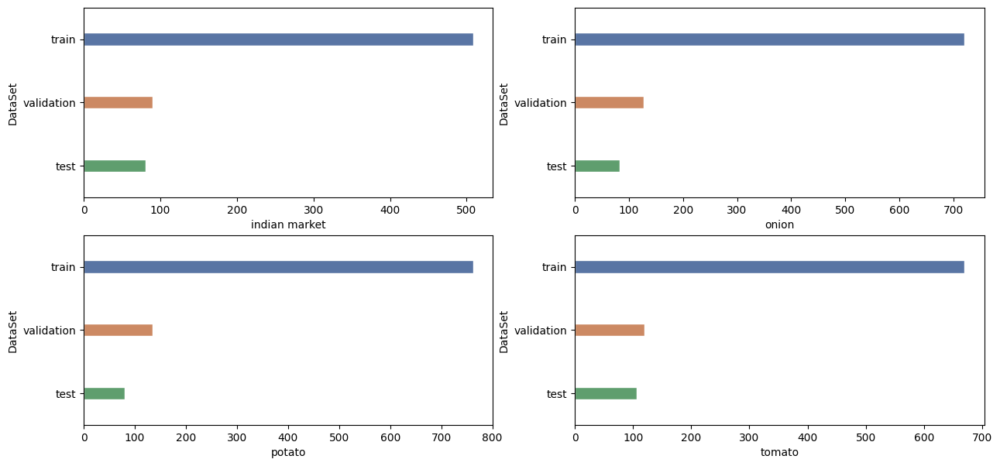

In [ ]:
fig, ax = plt.subplots(2, 2,figsize=(15, 7))
sns.set(font_scale=0.85)
sns.barplot(data=imagesCountDataframe, y="DataSet", x="indian market", errorbar="sd",width=0.2,ax=ax[0][0])
sns.barplot(data=imagesCountDataframe, y="DataSet", x="onion", errorbar="sd",width=0.2,ax=ax[0][1])
sns.barplot(data=imagesCountDataframe, y="DataSet", x="potato", errorbar="sd",width=0.2,ax=ax[1][0])
sns.barplot(data=imagesCountDataframe, y="DataSet", x="tomato", errorbar="sd",width=0.2,ax=ax[1][1])

Plotting image grids for each class in train set for dimension irregularities check

--------------- Train set : class is 'indian market'----------------


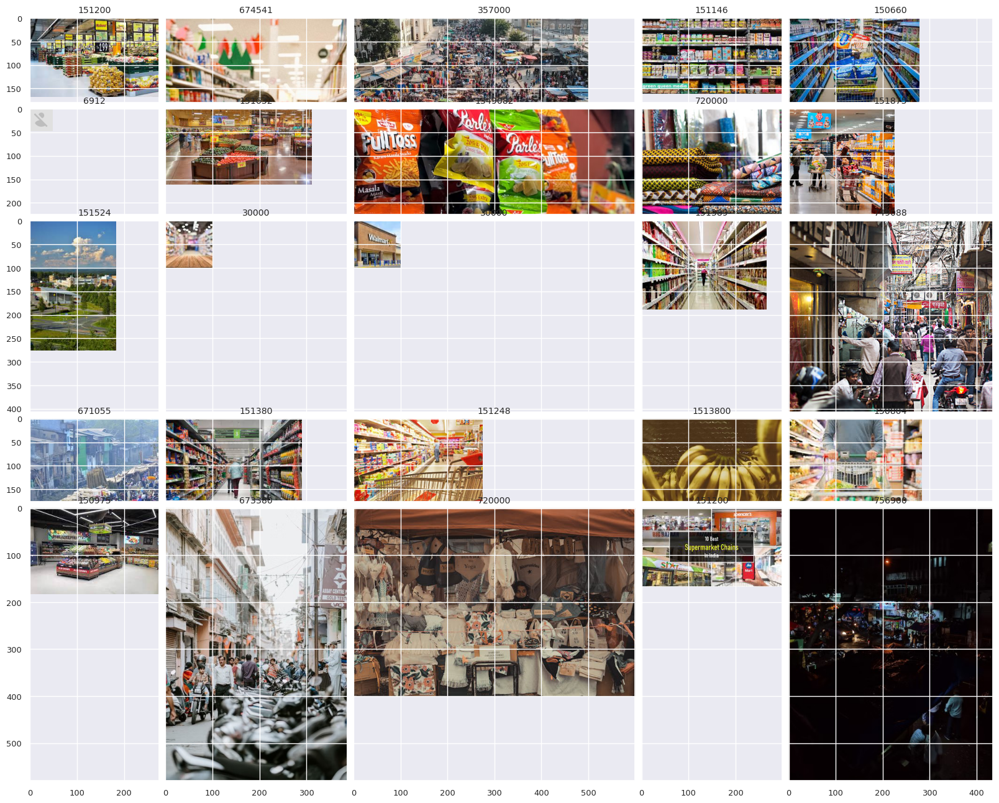

--------------- Train set : class is 'onion'----------------


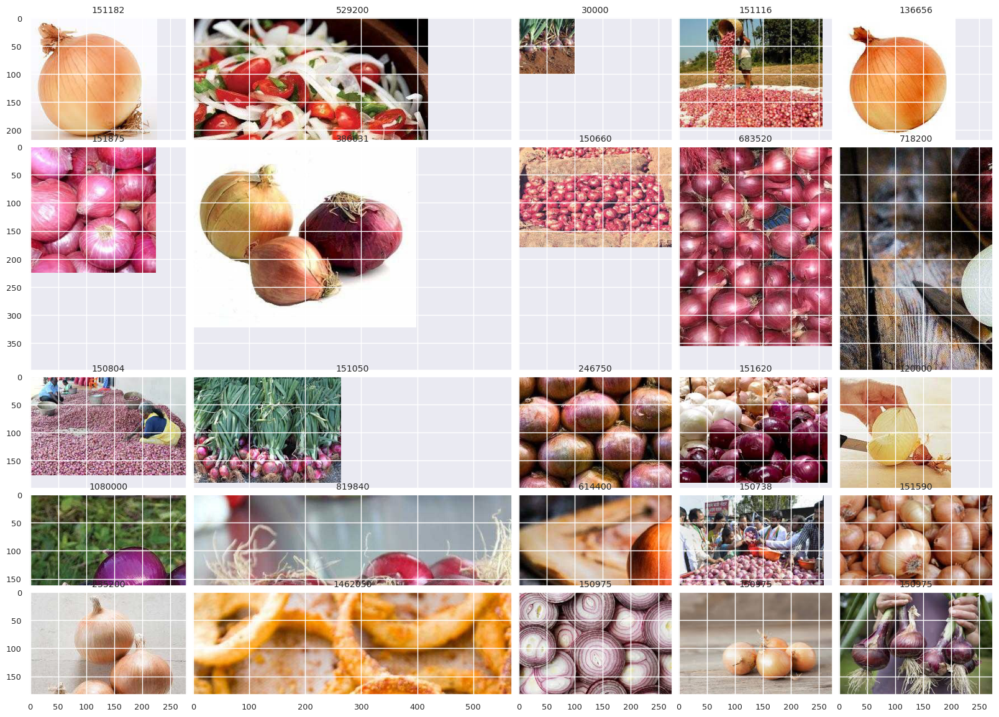

--------------- Train set : class is 'potato'----------------


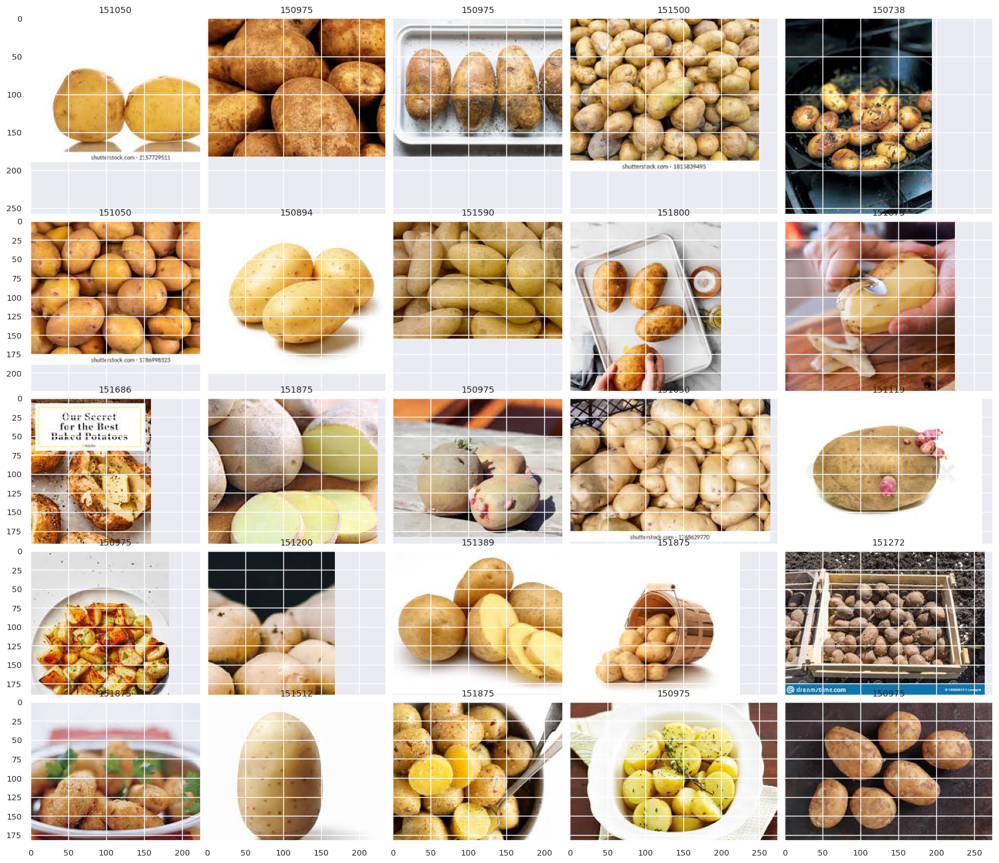

--------------- Train set : class is 'tomato'----------------


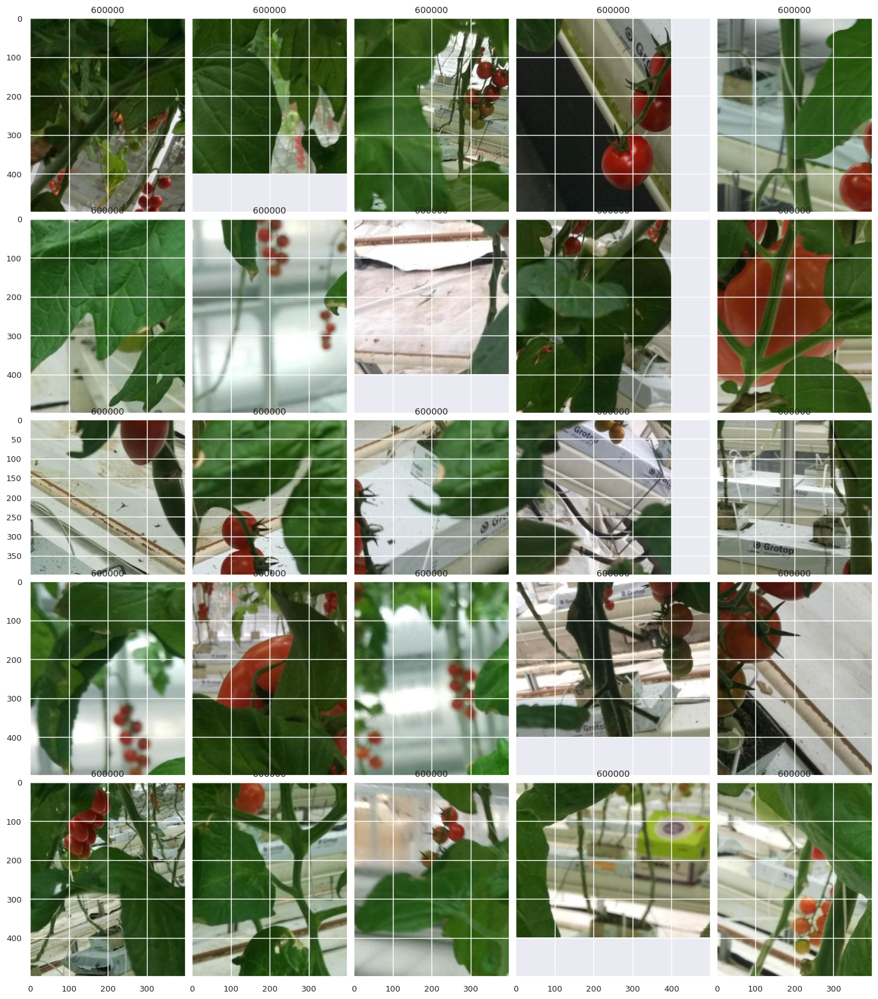

In [ ]:
for cls in classes_dir:
  img_arr=[]
  TrainFileNames = os.listdir(root_dir +'/train/' + cls)
  print("--------------- Train set : class is '"+cls+"'----------------")
  for image in TrainFileNames:
    img_arr.append(img_reshape(root_dir +'/train/' + cls +'/'+image))
  show_grid(img_arr,5,5)

Plotting image grids for each class in validation set for dimension irregularities check

--------------- validation set : class is 'indian market'----------------


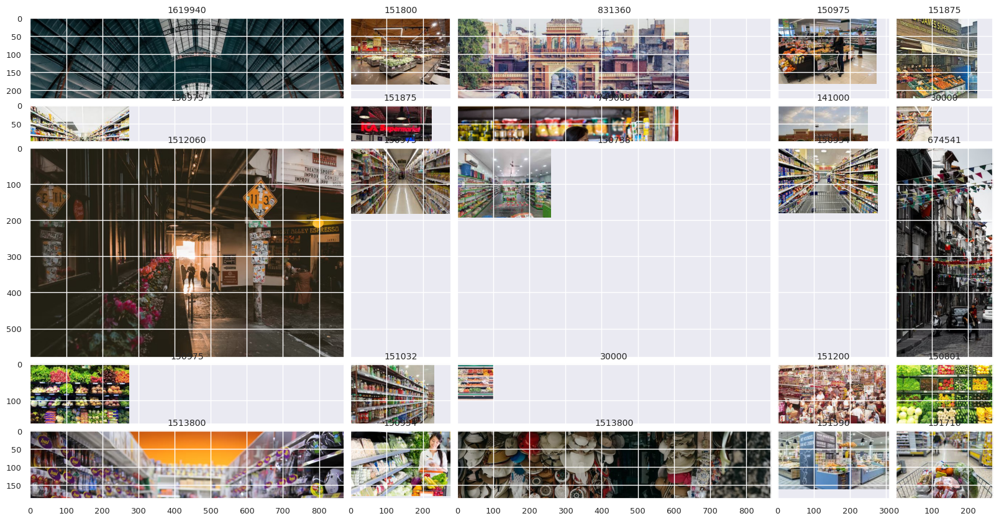

--------------- validation set : class is 'onion'----------------


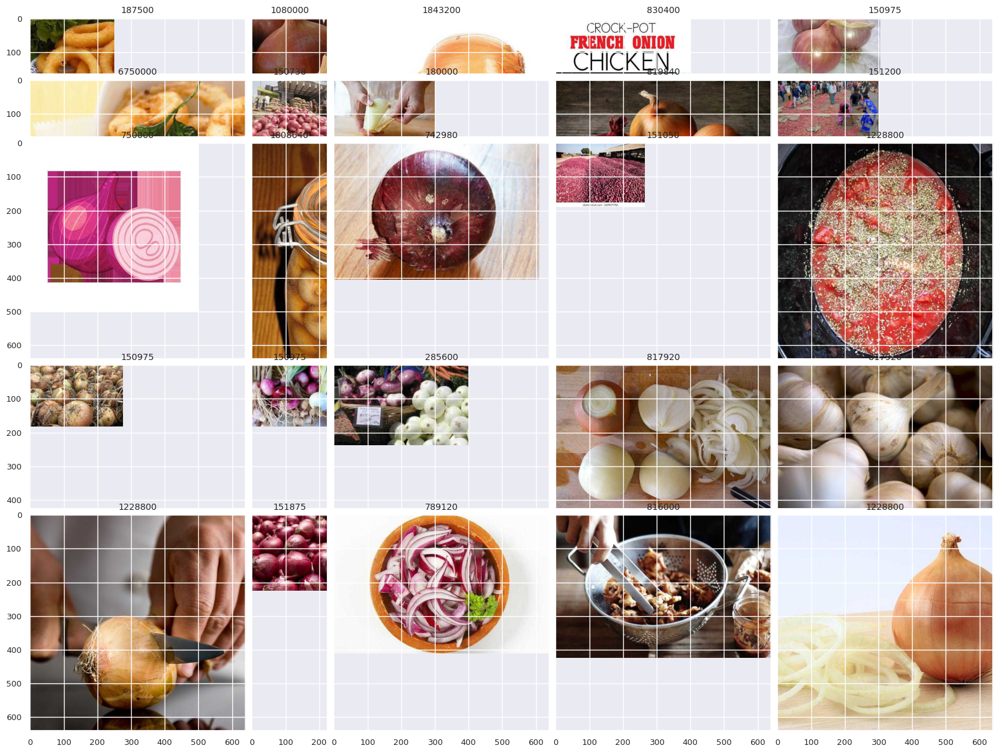

--------------- validation set : class is 'potato'----------------


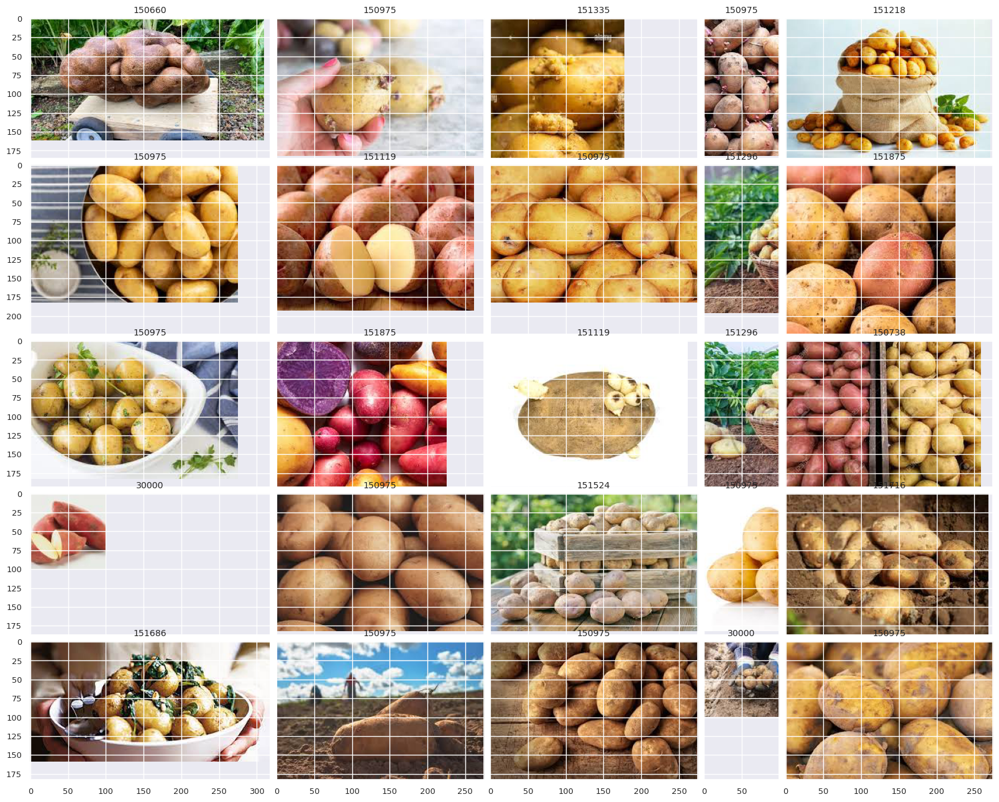

--------------- validation set : class is 'tomato'----------------


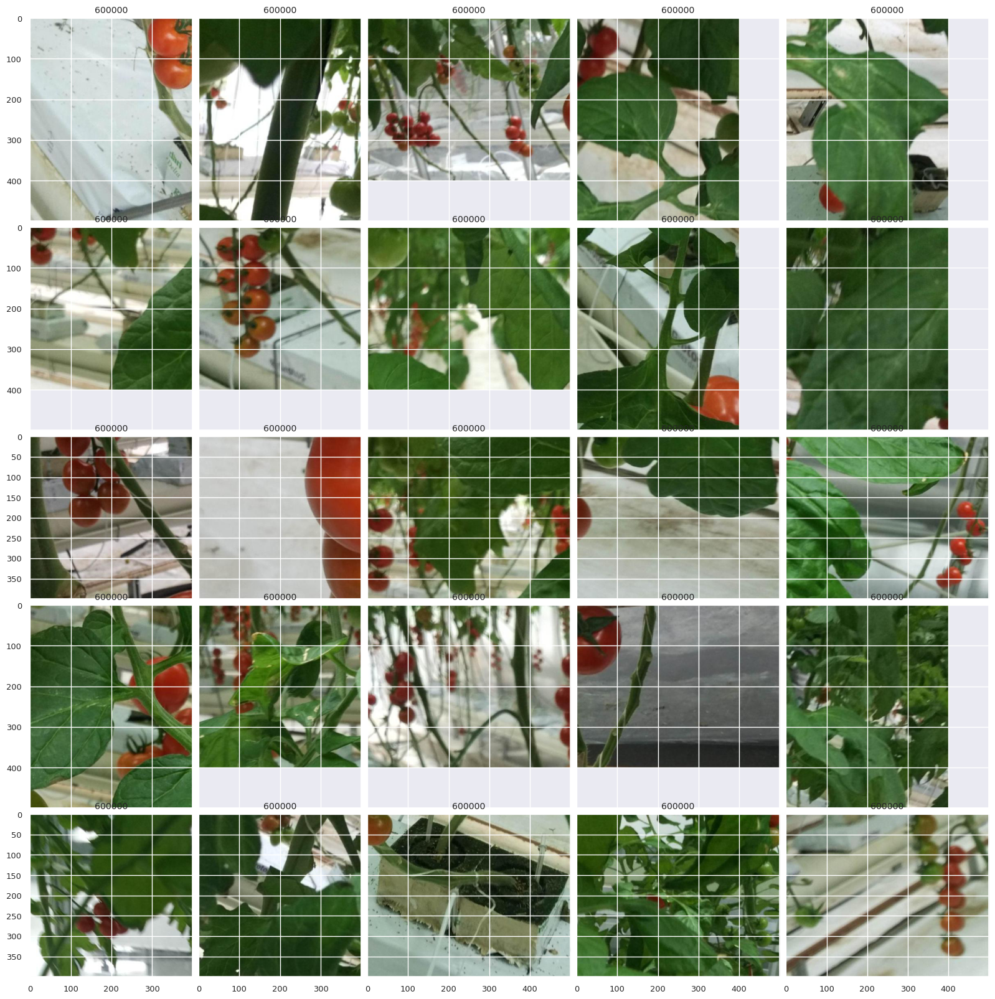

In [ ]:
for cls in classes_dir:
  img_arr=[]
  TrainFileNames = os.listdir(root_dir +'/validation/' + cls)
  print("--------------- validation set : class is '"+cls+"'----------------")
  for image in TrainFileNames:
    img_arr.append(img_reshape(root_dir +'/validation/' + cls +'/'+image))
  show_grid(img_arr)

Plotting image grids for each class in test set for dimension irregularities check

--------------- test set : class is 'indian market'----------------


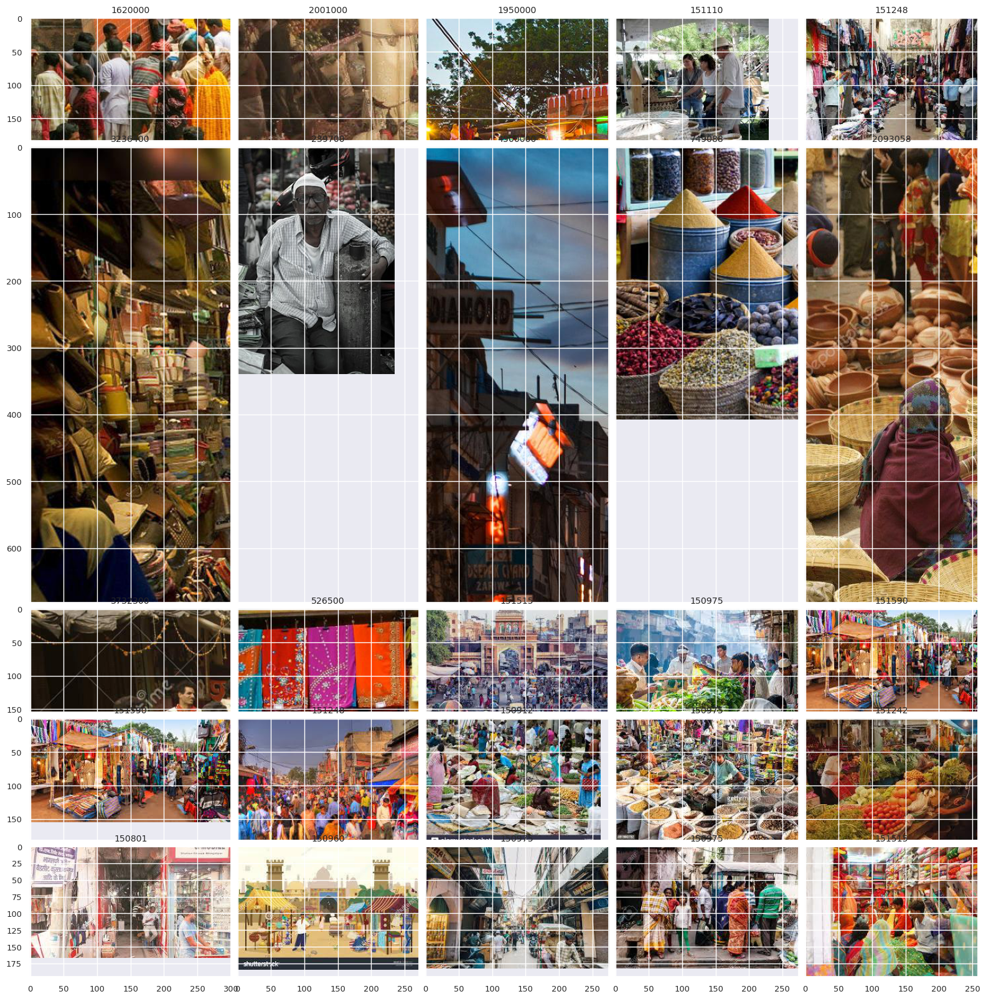

--------------- test set : class is 'onion'----------------


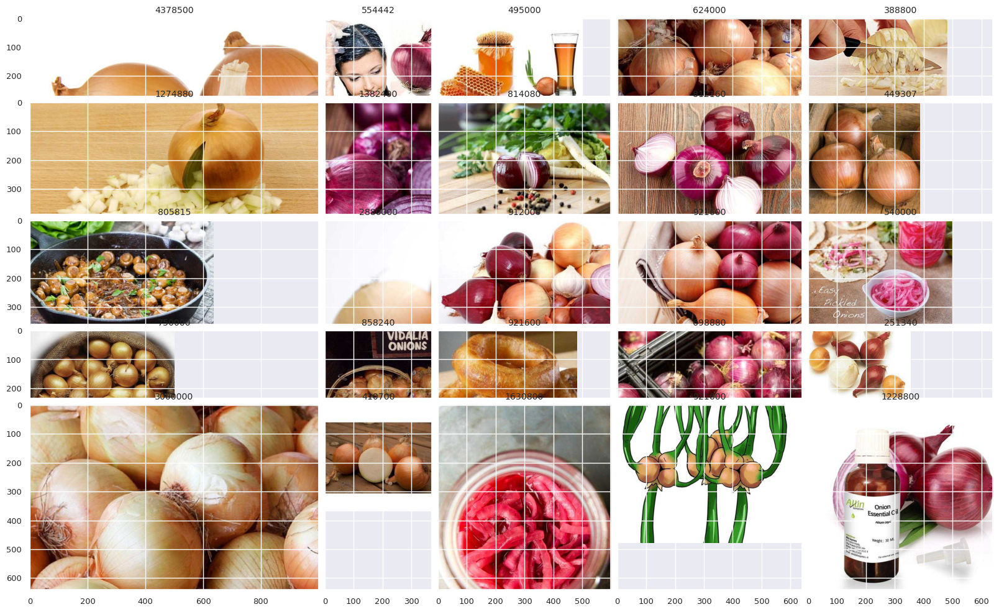

--------------- test set : class is 'potato'----------------


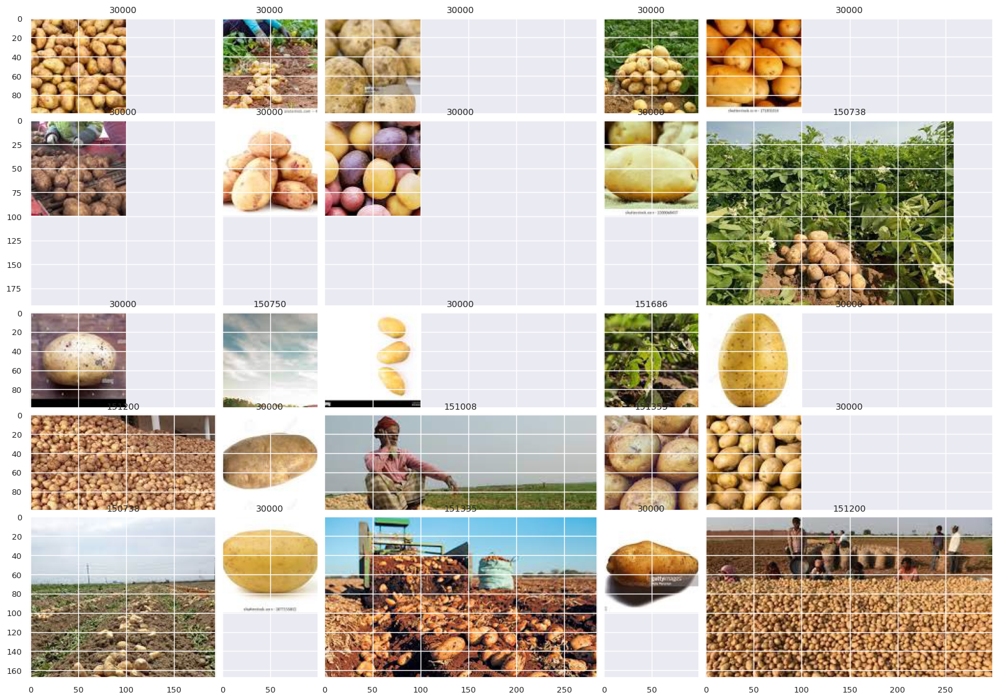

--------------- test set : class is 'tomato'----------------


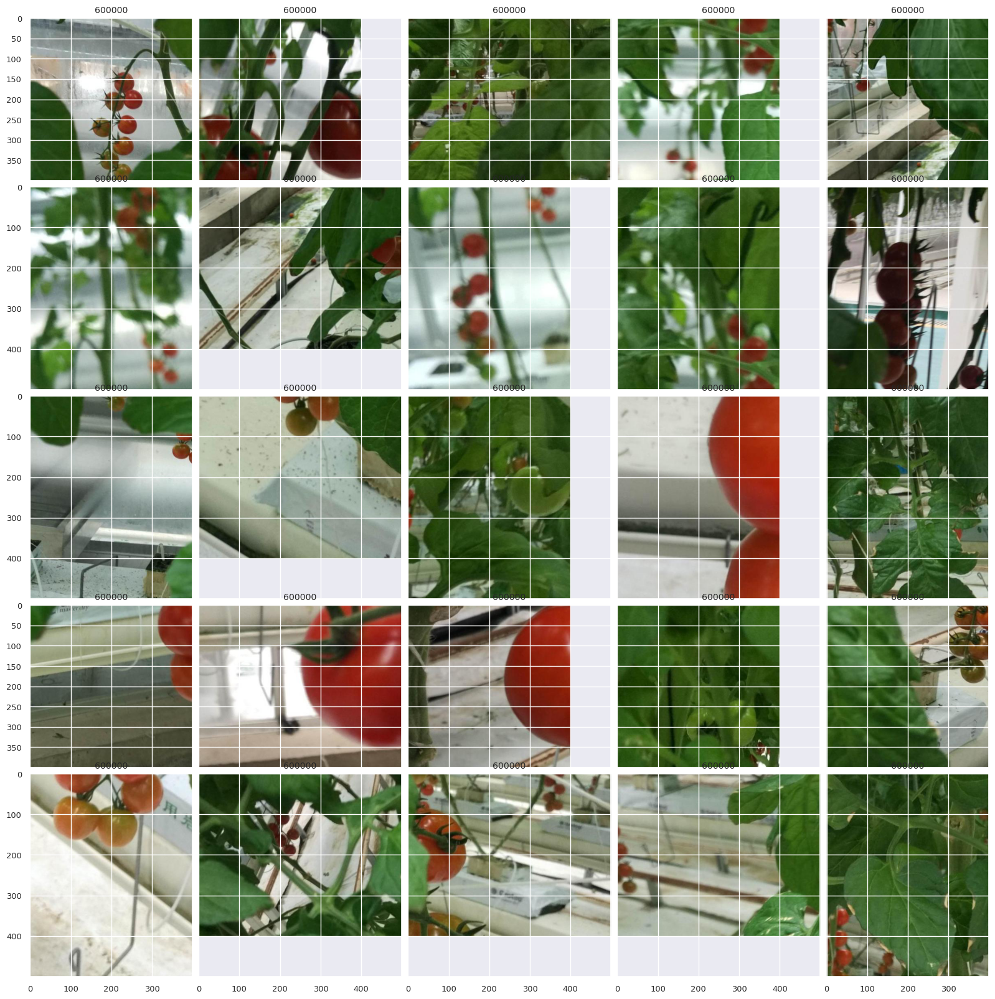

In [ ]:
for cls in classes_dir:
  img_arr=[]
  TrainFileNames = os.listdir(root_dir +'/test/' + cls)
  print("--------------- test set : class is '"+cls+"'----------------")
  for image in TrainFileNames:
    img_arr.append(img_reshape(root_dir +'/test/' + cls +'/'+image))
  show_grid(img_arr)

# Section 3: Creating base model architecture and training

**Preprocessing function**

In [ ]:
def prepareAndpreprocessDataFromFolders(trainfolderpath,validationfolderpath,testfolderpath,targetimage_width,targetimage_height,batch_size):
  BATCH_SIZE = batch_size
  tf.random.set_seed(10)
  np.random.seed(10)
  train_rawdata = tf.keras.utils.image_dataset_from_directory(trainfolderpath,shuffle =True, seed=123,image_size=(targetimage_width, targetimage_height),batch_size=BATCH_SIZE)
  val_rawdata   = tf.keras.utils.image_dataset_from_directory(validationfolderpath,shuffle =False, seed=123,image_size=(targetimage_width, targetimage_height),batch_size=BATCH_SIZE)
  test_rawdata = tf.keras.utils.image_dataset_from_directory(testfolderpath,shuffle =False, seed=123,image_size=(targetimage_width, targetimage_height),batch_size=BATCH_SIZE)

  data_preprocess = tf.keras.Sequential(
      name="data_preprocess",
      layers=[ layers.Rescaling(1.0/255),]
  )

  # Perform Data Processing on the train, val, test dataset
  train_ds = train_rawdata.map(lambda x, y: (data_preprocess(x), y),num_parallel_calls=tf.data.AUTOTUNE)
  val_ds = val_rawdata.map(lambda x, y: (data_preprocess(x), y),num_parallel_calls=tf.data.AUTOTUNE)
  test_ds = test_rawdata.map(lambda x, y: (data_preprocess(x), y),num_parallel_calls=tf.data.AUTOTUNE)

  return train_ds, val_ds, test_ds


In [ ]:
train_ds, val_ds, test_ds=prepareAndpreprocessDataFromFolders(root_dir +"/train/",root_dir +"/validation/",root_dir +"/test/",224,224,256)

Found 2663 files belonging to 4 classes.
Found 472 files belonging to 4 classes.
Found 351 files belonging to 4 classes.


**Baseline model architecture**

In [ ]:
def BaseModel_cnn_version1(height=128, width=128):
    num_classes = 4
    hidden_size = 256

    model = tf.keras.Sequential(
        name="BaseModel_cnn_version1",
        layers=[
            layers.Conv2D(filters=16, kernel_size=3, padding="same", activation='relu', input_shape=(height, width, 3)),
            layers.MaxPooling2D(),
            layers.Flatten(),
            layers.Dense(units=hidden_size, activation='relu'),
            layers.Dense(units=num_classes, activation='softmax')
        ]
    )
    return model

In [ ]:
BaseModel_cnn_version1_model = BaseModel_cnn_version1(224,224)
BaseModel_cnn_version1_model.summary()

Model: "BaseModel_cnn_version1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 224, 224, 16)      448       
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 112, 112, 16)     0         
 2D)                                                             
                                                                 
 flatten_2 (Flatten)         (None, 200704)            0         
                                                                 
 dense_4 (Dense)             (None, 256)               51380480  
                                                                 
 dense_5 (Dense)             (None, 4)                 1028      
                                                                 
Total params: 51,381,956
Trainable params: 51,381,956
Non-trainable params: 0
________________________________

**Compile and Train**

In [ ]:
def compile_train_BaseModel_cnn_version1(model, train_ds, val_ds, ckpt_path= root_dir+"/base_ver1_chkpnt/checkpoint"):
    epochs = 10
    model.compile(optimizer='adam',
                loss = 'sparse_categorical_crossentropy',
                metrics=['accuracy'])

    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=epochs, callbacks=[
        tf.keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_accuracy', mode='max', save_best_only=True),
    ])
    return model_fit

In [ ]:
BaseModel_cnn_version1_model_fit = compile_train_BaseModel_cnn_version1(BaseModel_cnn_version1_model, train_ds, val_ds)

Epoch 1/10
11/11 [==============================] - 18s 624ms/step - loss: 18.8822 - accuracy: 0.3162 - val_loss: 7.3811 - val_accuracy: 0.3877
Epoch 2/10
11/11 [==============================] - 19s 844ms/step - loss: 4.4781 - accuracy: 0.4502 - val_loss: 1.2264 - val_accuracy: 0.5953
Epoch 3/10
11/11 [==============================] - 18s 939ms/step - loss: 1.3297 - accuracy: 0.5989 - val_loss: 0.9054 - val_accuracy: 0.6780
Epoch 4/10
11/11 [==============================] - 18s 779ms/step - loss: 0.8717 - accuracy: 0.7003 - val_loss: 0.8701 - val_accuracy: 0.7182
Epoch 5/10
11/11 [==============================] - 20s 1s/step - loss: 0.6674 - accuracy: 0.7814 - val_loss: 0.7156 - val_accuracy: 0.7521
Epoch 6/10
11/11 [==============================] - 18s 820ms/step - loss: 0.5170 - accuracy: 0.8397 - val_loss: 0.5929 - val_accuracy: 0.7775
Epoch 7/10
11/11 [==============================] - 18s 831ms/step - loss: 0.4053 - accuracy: 0.8795 - val_loss: 0.5636 - val_accuracy: 0.8051
E

**Plot Train and Validation Accuracy**

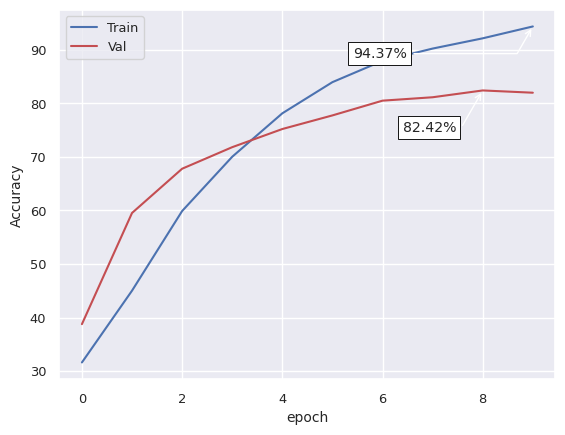

In [ ]:
plot_accuracy(BaseModel_cnn_version1_model_fit)

**Analyze Result on Test Dataset**

2/2 [==============================] - 1s 568ms/step

Test Accuracy: 76.35%

2/2 [==============================] - 1s 557ms/step


<Figure size 800x500 with 0 Axes>

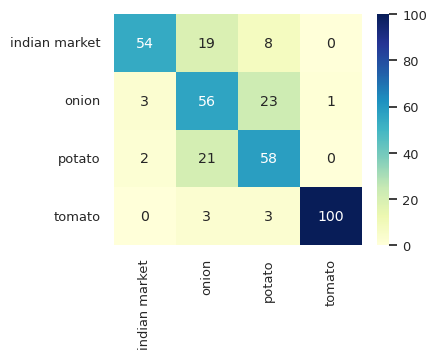

In [ ]:
model_toTest=BaseModel_cnn_version1(224,224)
print_accuracy_stats(model_toTest, test_ds,root_dir+"/base_ver1_chkpnt/checkpoint")
plot_confusion_matrix(model_toTest, test_ds,root_dir+"/base_ver1_chkpnt/checkpoint",['indian market','onion','potato','tomato'])

**Observation:**

Validation Accuracy is low as compared to Training Accuracy (better known as Overfitting)

Overfitting = More Trainable Parameters, Less Training Samples 

**Solutions -**

More Data, Data Augmentation

Reducing Complexity of Model Architecture (Smaller Model)

Adding Regularizer to Model

Adding Regularizer to Loss Function

# Section 4: Creating base model architecture with reduction in parameters(version2) and training

**To reduce learnable parameters we will do below in version2 architecture:**

1.   Reduce the 3D volume before the flatten layer by using more Convolution blocks.
2.   Replace the flatten layer by GlobalAveragePooling2D


In [ ]:
def BaseModel_cnn_version2(height=128, width=128):
    num_classes = 4
    hidden_size = 256

    model = tf.keras.Sequential(
        name="BaseModel_cnn_version2",
        layers=[
            layers.Conv2D(filters=16, kernel_size=3, padding="same", activation='relu', input_shape=(height, width, 3)),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=32, kernel_size=3, padding="same", activation='relu'),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=64, kernel_size=3, padding="same", activation='relu'),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=128, kernel_size=3, padding="same", activation='relu'),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=256, kernel_size=3, padding="same", activation='relu'),
            layers.GlobalAveragePooling2D(),
            layers.Dense(units=hidden_size, activation='relu'),
            layers.Dense(units=num_classes, activation='softmax')
        ]
    )
    return model

In [ ]:
BaseModel_cnn_version2_model = BaseModel_cnn_version2(224,224)
BaseModel_cnn_version2_model.summary()

Model: "BaseModel_cnn_version2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 16)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 56, 56, 64)        18496     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 28, 28,

**Achievement and observation:**

Basemodel version1 params count : Total params: 51,381,956

Basemodel version2 params count : Total params: 459,428

Around 99% params count has been decreased.

**Compile and Train**

In [ ]:
def compile_train_BaseModel_cnn_version2(model, train_ds, val_ds, ckpt_path,noofepochs=10):
    epochs = noofepochs
    model.compile(optimizer='adam',
                loss = 'sparse_categorical_crossentropy',
                metrics=['accuracy'])

    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=epochs, callbacks=[
        tf.keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_accuracy', mode='max', save_best_only=True),
    ])
    return model_fit

In [ ]:
BaseModel_cnn_version2_model_fit = compile_train_BaseModel_cnn_version2(BaseModel_cnn_version2_model, train_ds, val_ds,root_dir+"/base_ver2_chkpnt/checkpoint",10)

Epoch 1/10
11/11 [==============================] - 17s 442ms/step - loss: 1.0695 - accuracy: 0.6173 - val_loss: 0.7551 - val_accuracy: 0.7267
Epoch 2/10
11/11 [==============================] - 14s 606ms/step - loss: 0.7458 - accuracy: 0.7075 - val_loss: 0.6533 - val_accuracy: 0.7627
Epoch 3/10
11/11 [==============================] - 15s 514ms/step - loss: 0.6030 - accuracy: 0.7773 - val_loss: 0.5840 - val_accuracy: 0.7775
Epoch 4/10
11/11 [==============================] - 15s 538ms/step - loss: 0.5198 - accuracy: 0.7961 - val_loss: 0.5096 - val_accuracy: 0.7775
Epoch 5/10
11/11 [==============================] - 16s 516ms/step - loss: 0.4750 - accuracy: 0.8081 - val_loss: 0.5213 - val_accuracy: 0.7881
Epoch 6/10
11/11 [==============================] - 15s 635ms/step - loss: 0.4763 - accuracy: 0.8092 - val_loss: 0.4697 - val_accuracy: 0.8093
Epoch 7/10
11/11 [==============================] - 17s 866ms/step - loss: 0.4456 - accuracy: 0.8186 - val_loss: 0.4613 - val_accuracy: 0.8136

**Plot Train and Validation Accuracy**

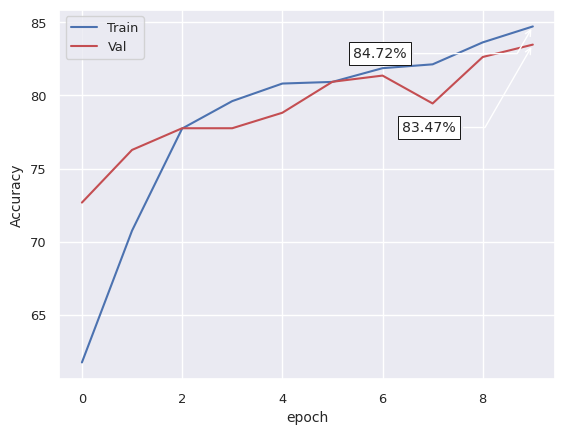

In [ ]:
plot_accuracy(BaseModel_cnn_version2_model_fit)

**Analyze Result on Test Dataset**

2/2 [==============================] - 9s 3s/step

Test Accuracy: 78.06%

2/2 [==============================] - 8s 2s/step


<Figure size 800x500 with 0 Axes>

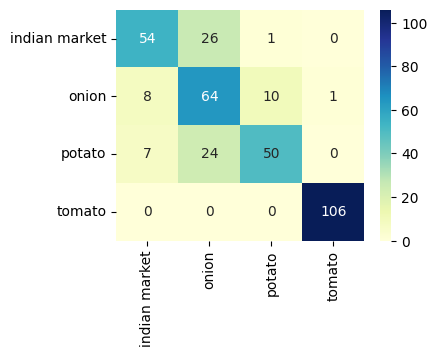

In [ ]:
model_toTest=BaseModel_cnn_version2(224,224)
print_accuracy_stats(model_toTest, test_ds,root_dir+"/base_ver2_chkpnt/checkpoint")
plot_confusion_matrix(model_toTest, test_ds,root_dir+"/base_ver2_chkpnt/checkpoint",['indian market','onion','potato','tomato'])

**Observation:**

Validation Accuracy is almost as compared to Training Accuracy(overfitting problem is almost cleared)

But accuracy is less which is around 78% => we have underfitting problem, let run same architecture for more epochs to observe plateaus occurred or not


In [ ]:
BaseModel_cnn_version2_model_fit_30Epochs = compile_train_BaseModel_cnn_version2(BaseModel_cnn_version2_model, train_ds, val_ds,root_dir+"/base_ver2_chkpnt_30/checkpoint",30)

Epoch 1/30
11/11 [==============================] - 107s 9s/step - loss: 1.3318 - accuracy: 0.3162 - val_loss: 1.1858 - val_accuracy: 0.5000
Epoch 2/30
11/11 [==============================] - 15s 594ms/step - loss: 1.0800 - accuracy: 0.5629 - val_loss: 0.9632 - val_accuracy: 0.5487
Epoch 3/30
11/11 [==============================] - 15s 591ms/step - loss: 0.8724 - accuracy: 0.6226 - val_loss: 0.7043 - val_accuracy: 0.6610
Epoch 4/30
11/11 [==============================] - 15s 650ms/step - loss: 0.6904 - accuracy: 0.7101 - val_loss: 0.7010 - val_accuracy: 0.6907
Epoch 5/30
11/11 [==============================] - 14s 512ms/step - loss: 0.7128 - accuracy: 0.7090 - val_loss: 0.6055 - val_accuracy: 0.7691
Epoch 6/30
11/11 [==============================] - 16s 847ms/step - loss: 0.6498 - accuracy: 0.7458 - val_loss: 0.6672 - val_accuracy: 0.7288
Epoch 7/30
11/11 [==============================] - 15s 580ms/step - loss: 0.5911 - accuracy: 0.7754 - val_loss: 0.5373 - val_accuracy: 0.7839
E

**Plot Train and Validation Accuracy**

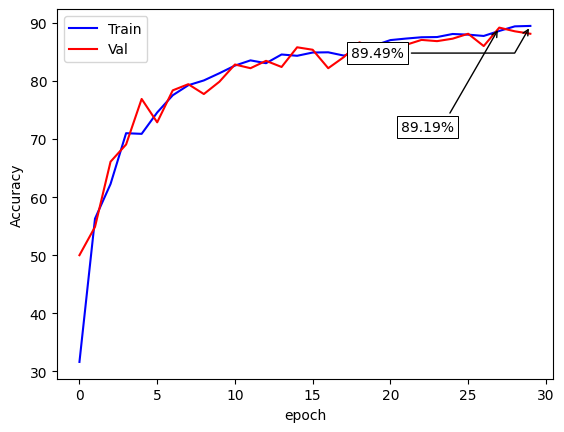

In [ ]:
plot_accuracy(BaseModel_cnn_version2_model_fit_30Epochs)

**Analyze Result on Test Dataset**

2/2 [==============================] - 2s 1s/step

Test Accuracy: 84.62%

2/2 [==============================] - 1s 544ms/step


<Figure size 800x500 with 0 Axes>

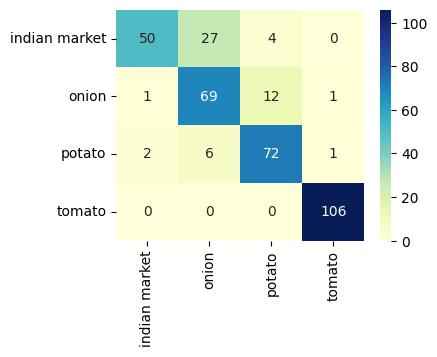

In [ ]:
model_toTest=BaseModel_cnn_version2(224,224)
print_accuracy_stats(model_toTest, test_ds,root_dir+"/base_ver2_chkpnt_30/checkpoint")
plot_confusion_matrix(model_toTest, test_ds,root_dir+"/base_ver2_chkpnt_30/checkpoint",['indian market','onion','potato','tomato'])

**Observation:**

Validation Accuracy is **almost as compared to Training Accuracy**(overfitting problem is almost cleared) and both are improved compared to version1.

But accuracy is around 84% =>  **we can improve on it.**

We see the training is not very stable with fluctuations. 

How to solve this issue?
Fluctuating (heartbeat) plots imply that the learning rate is too high.

Better alternative is to use a Learning Rate Scheduler and let the model train until the loss/accuracy curve flattens out called Early Stopping.

# Section 5: Creating base model architecture(version2) with callbacks and training

**ReduceLROnPlateau,ModelCheckpoint,EarlyStopping** - call backs have been added to reduce fluctuations

In [ ]:
def compile_train_BaseModel_cnn_version2_withCallbacks(model, train_ds, val_ds, ckpt_path,noofepochs=10):
    callbacks = [
        tf.keras.callbacks.ReduceLROnPlateau(
            monitor="val_loss", factor=0.3, patience=5, min_lr=0.00001
        ),
        tf.keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_accuracy', mode='max', save_best_only=True),
        tf.keras.callbacks.EarlyStopping(
            monitor="val_loss", patience=10, min_delta=0.001, mode='min'
        )
    ]
    model.compile(optimizer='adam',
                loss='sparse_categorical_crossentropy',
                metrics=['accuracy'])
    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=noofepochs, callbacks=callbacks)
    return model_fit

In [ ]:
BaseModel_cnn_version2_modelWithCallbacks = BaseModel_cnn_version2(224,224)

In [ ]:
BaseModel_cnn_version2_30Epochs_withCallBacks_model_fit = compile_train_BaseModel_cnn_version2_withCallbacks(BaseModel_cnn_version2_modelWithCallbacks, train_ds, val_ds,root_dir+"/base_ver2_chk_withcallbacks/checkpoint",30)

Epoch 1/30
11/11 [==============================] - 20s 787ms/step - loss: 1.1676 - accuracy: 0.5475 - val_loss: 0.8588 - val_accuracy: 0.6441 - lr: 0.0010
Epoch 2/30
11/11 [==============================] - 15s 684ms/step - loss: 0.8722 - accuracy: 0.6286 - val_loss: 0.7819 - val_accuracy: 0.6610 - lr: 0.0010
Epoch 3/30
11/11 [==============================] - 15s 588ms/step - loss: 0.7307 - accuracy: 0.6894 - val_loss: 0.6562 - val_accuracy: 0.7097 - lr: 0.0010
Epoch 4/30
11/11 [==============================] - 17s 853ms/step - loss: 0.6277 - accuracy: 0.7368 - val_loss: 0.5707 - val_accuracy: 0.7479 - lr: 0.0010
Epoch 5/30
11/11 [==============================] - 14s 603ms/step - loss: 0.5588 - accuracy: 0.7743 - val_loss: 0.5610 - val_accuracy: 0.7754 - lr: 0.0010
Epoch 6/30
11/11 [==============================] - 15s 591ms/step - loss: 0.5431 - accuracy: 0.7931 - val_loss: 0.5469 - val_accuracy: 0.7860 - lr: 0.0010
Epoch 7/30
11/11 [==============================] - 14s 510ms/st

**Plot Train and Validation Accuracy**

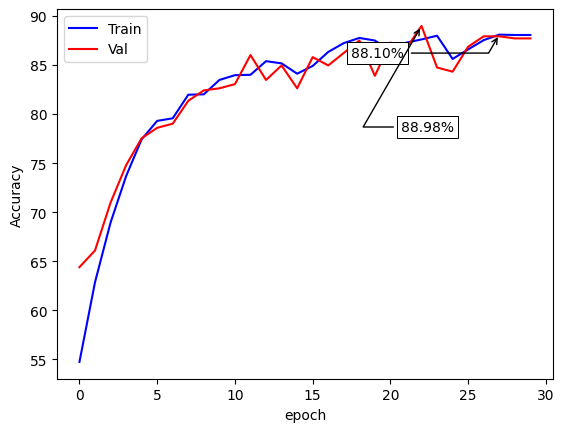

In [ ]:
plot_accuracy(BaseModel_cnn_version2_30Epochs_withCallBacks_model_fit)

**Analyze Result on Test Dataset**

2/2 [==============================] - 1s 538ms/step

Test Accuracy: 84.62%

2/2 [==============================] - 1s 522ms/step


<Figure size 800x500 with 0 Axes>

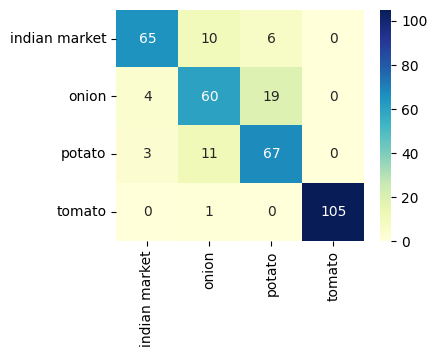

In [ ]:
model_toTest=BaseModel_cnn_version2(224,224)
print_accuracy_stats(model_toTest, test_ds,root_dir+"/base_ver2_chk_withcallbacks/checkpoint")
plot_confusion_matrix(model_toTest, test_ds,root_dir+"/base_ver2_chk_withcallbacks/checkpoint",['indian market','onion','potato','tomato'])

**Observation:**

By adding callbacks related to learning rate scheduler, we havent seen improvement on fluctuations.

We can add  L2 regularization,dropout layers,batch normalization layers to see improvement on overfitting and fluctuations perspective.

batch normalization-helps in model optimization perspective as well.

# Section 6: Addtion of L2 regularization,dropout and batch normalization(version3)

In [ ]:
def BaseModel_cnn_version3(height=128, width=128):
    num_classes = 4
    hidden_size = 256

    model = tf.keras.Sequential(
        name="BaseModel_cnn_version3",
        layers=[
            layers.Conv2D(filters=16, kernel_size=3, padding="same", input_shape=(height, width, 3),
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=32, kernel_size=3, padding="same",
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=64, kernel_size=3, padding="same",
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=128, kernel_size=3, padding="same",
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=256, kernel_size=3, padding="same",
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            # layers.MaxPooling2D(),
            # layers.Flatten(),
            layers.GlobalAveragePooling2D(),
            layers.Dense(units=hidden_size, kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.Dropout(0.5),
            layers.Dense(units=num_classes, activation='softmax')
        ]
    )
    return model

**Dropout,batch normalization added as part of architecture.**

**L2 Regularizer has been added, to see effect on overfitting problem**

In [ ]:
BaseModel_cnn_version3_model = BaseModel_cnn_version3(224,224)
BaseModel_cnn_version3_model.summary()

Model: "BaseModel_cnn_version3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 224, 224, 16)      448       
                                                                 
 activation (Activation)     (None, 224, 224, 16)      0         
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 16)     64        
 ormalization)                                                   
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 112, 112, 16)     0         
 2D)                                                             
                                                                 
 conv2d_6 (Conv2D)           (None, 112, 112, 32)      4640      
                                                                 
 activation_1 (Activation)   (None, 112, 112

**Compile and Train**

In [ ]:
def compile_train_BaseModel_cnn_version3(model, train_ds, val_ds, ckpt_path,noofepochs=10):
    callbacks = [
        tf.keras.callbacks.ReduceLROnPlateau(
            monitor="val_loss", factor=0.3, patience=5, min_lr=0.00001
        ),
        tf.keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_accuracy', mode='max', save_best_only=True),
        tf.keras.callbacks.EarlyStopping(
            monitor="val_loss", patience=10, min_delta=0.001, mode='min'
        )
    ]
    model.compile(optimizer='adam',
                loss='sparse_categorical_crossentropy',
                metrics=['accuracy'])
    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=noofepochs, callbacks=callbacks)

    return model_fit

In [ ]:
BaseModel_cnn_version3_model_fit = compile_train_BaseModel_cnn_version3(BaseModel_cnn_version3_model, train_ds, val_ds,root_dir+"/base_ver3_chkpnt/checkpoint",30)

Epoch 1/30
11/11 [==============================] - 23s 601ms/step - loss: 0.6051 - accuracy: 0.9144 - val_loss: 2.3619 - val_accuracy: 0.4640 - lr: 0.0010
Epoch 2/30
11/11 [==============================] - 15s 723ms/step - loss: 0.4988 - accuracy: 0.9433 - val_loss: 2.4855 - val_accuracy: 0.4619 - lr: 0.0010
Epoch 3/30
11/11 [==============================] - 15s 596ms/step - loss: 0.4637 - accuracy: 0.9564 - val_loss: 2.0038 - val_accuracy: 0.5508 - lr: 0.0010
Epoch 4/30
11/11 [==============================] - 19s 921ms/step - loss: 0.4236 - accuracy: 0.9662 - val_loss: 2.0109 - val_accuracy: 0.5784 - lr: 0.0010
Epoch 5/30
11/11 [==============================] - 17s 676ms/step - loss: 0.4124 - accuracy: 0.9688 - val_loss: 1.5884 - val_accuracy: 0.6653 - lr: 0.0010
Epoch 6/30
11/11 [==============================] - 15s 570ms/step - loss: 0.3917 - accuracy: 0.9722 - val_loss: 1.8141 - val_accuracy: 0.6335 - lr: 0.0010
Epoch 7/30
11/11 [==============================] - 14s 625ms/st

**Plot Train and Validation Accuracy**

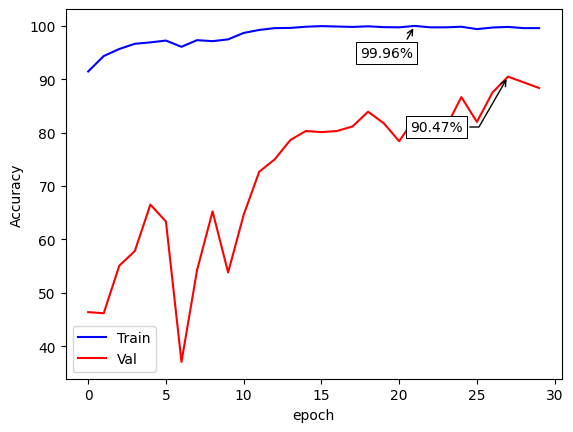

In [ ]:
plot_accuracy(BaseModel_cnn_version3_model_fit)

**Analyze Result on Test Dataset**

2/2 [==============================] - 2s 597ms/step

Test Accuracy: 85.19%

2/2 [==============================] - 1s 542ms/step


<Figure size 800x500 with 0 Axes>

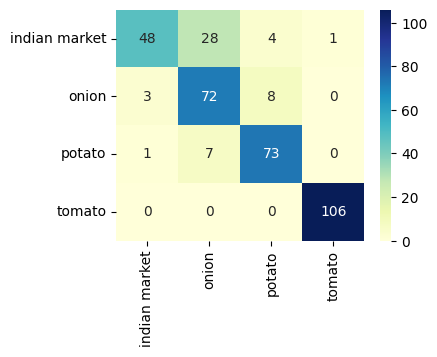

In [ ]:
model_toTest=BaseModel_cnn_version3(224,224)
print_accuracy_stats(model_toTest, test_ds,root_dir+"/base_ver3_chkpnt/checkpoint")
plot_confusion_matrix(model_toTest, test_ds,root_dir+"/base_ver3_chkpnt/checkpoint",['indian market','onion','potato','tomato'])

**Observation:**

Training data fluctuations are reduced,but still we see fluctuations in validation accuracy.

But still we have very less improvement in test data accuracy.So we try to do different preprocessing of data to add more variation **with data augmentation setup.** 

# Section 7: Addition of Data Augmentation as preprocessing to improve test Accuracy

In [ ]:
def prepareAndpreprocessDataFromFolders_WithDataAugmentation(trainfolderpath,validationfolderpath,testfolderpath,targetimage_height,targetimage_width,batch_size):
    BATCH_SIZE = batch_size
    tf.random.set_seed(10)
    np.random.seed(10)
    train_rawdata = tf.keras.utils.image_dataset_from_directory(trainfolderpath,shuffle =True, seed=123,image_size=(targetimage_width, targetimage_height),batch_size=BATCH_SIZE)
    val_rawdata   = tf.keras.utils.image_dataset_from_directory(validationfolderpath,shuffle =False, seed=123,image_size=(targetimage_width, targetimage_height),batch_size=BATCH_SIZE)
    test_rawdata = tf.keras.utils.image_dataset_from_directory(testfolderpath,shuffle =False, seed=123,image_size=(targetimage_width, targetimage_height),batch_size=BATCH_SIZE)

    # Data Processing Stage with resizing and rescaling operations #same as before for test,val
    data_preprocess = tf.keras.Sequential(
        name="data_preprocess",
        layers=[
            layers.Rescaling(1.0/255),
        ]
    )

    # Data Processing Stage with resizing and rescaling operations
    data_augmentation = tf.keras.Sequential(
        name="data_augmentation",
        layers=[
            layers.Resizing(156, 156), # First resize to 156,156
            layers.RandomCrop(targetimage_height, targetimage_width), # Then randomly crop 128,128 region
            # layers.RandomBrightness(0.2), # Modify brightness by 0.2 factor
            layers.Rescaling(1.0/255), # Finally rescale
        ]
    )

    # Perform Data Processing on the train, val, test dataset
    train_ds = train_rawdata.map(
        lambda x, y: (data_augmentation(x), y), num_parallel_calls=tf.data.AUTOTUNE
    ).prefetch(tf.data.AUTOTUNE)
    val_ds = val_rawdata.map(
        lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE
    ).prefetch(tf.data.AUTOTUNE)
    test_ds = test_rawdata.map(
        lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE
    ).prefetch(tf.data.AUTOTUNE)

    return train_ds, val_ds, test_ds

In [ ]:
train_ds_Aug, val_ds, test_ds=prepareAndpreprocessDataFromFolders_WithDataAugmentation(root_dir +"/train/",root_dir +"/validation/",root_dir +"/test/",224,224,256)

Found 2663 files belonging to 4 classes.
Found 472 files belonging to 4 classes.
Found 351 files belonging to 4 classes.


In [ ]:
BaseModel_cnn_version3_model_fit_withAugmenteddata = compile_train_BaseModel_cnn_version3(BaseModel_cnn_version3_model, train_ds_Aug, val_ds,root_dir+"/base_ver3_DataAug_chkpnt/checkpoint",50)

Epoch 1/50
11/11 [==============================] - 23s 722ms/step - loss: 0.5311 - accuracy: 0.9174 - val_loss: 2.6789 - val_accuracy: 0.6970 - lr: 0.0010
Epoch 2/50
11/11 [==============================] - 18s 771ms/step - loss: 0.3953 - accuracy: 0.9369 - val_loss: 0.9889 - val_accuracy: 0.8284 - lr: 0.0010
Epoch 3/50
11/11 [==============================] - 18s 737ms/step - loss: 0.3579 - accuracy: 0.9452 - val_loss: 0.6070 - val_accuracy: 0.9089 - lr: 0.0010
Epoch 4/50
11/11 [==============================] - 16s 764ms/step - loss: 0.3422 - accuracy: 0.9489 - val_loss: 0.6198 - val_accuracy: 0.8983 - lr: 0.0010
Epoch 5/50
11/11 [==============================] - 18s 675ms/step - loss: 0.3137 - accuracy: 0.9647 - val_loss: 0.6356 - val_accuracy: 0.8475 - lr: 0.0010
Epoch 6/50
11/11 [==============================] - 15s 725ms/step - loss: 0.2863 - accuracy: 0.9670 - val_loss: 0.4784 - val_accuracy: 0.9216 - lr: 0.0010
Epoch 7/50
11/11 [==============================] - 15s 583ms/st

**Plot Train and Validation Accuracy**

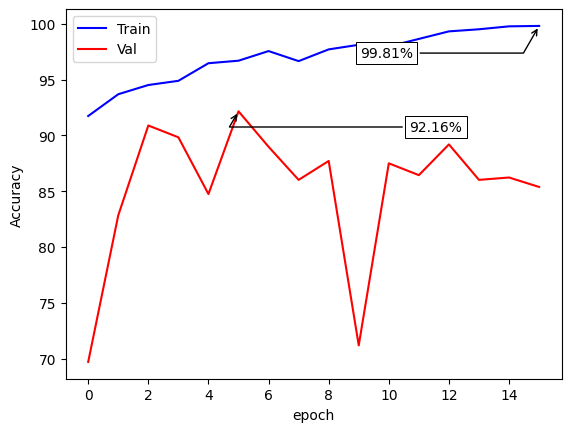

In [ ]:
plot_accuracy(BaseModel_cnn_version3_model_fit_withAugmenteddata)

**Analyze Result on Test Dataset**

2/2 [==============================] - 1s 583ms/step

Test Accuracy: 84.62%

2/2 [==============================] - 2s 1s/step


<Figure size 800x500 with 0 Axes>

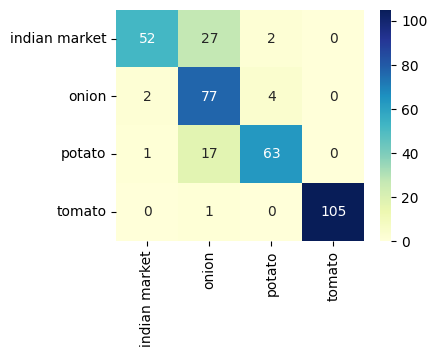

In [ ]:
model_toTest=BaseModel_cnn_version3(224,224)
print_accuracy_stats(model_toTest, test_ds,root_dir+"/base_ver3_DataAug_chkpnt/checkpoint")
plot_confusion_matrix(model_toTest, test_ds,root_dir+"/base_ver3_DataAug_chkpnt/checkpoint",['indian market','onion','potato','tomato'])

**Observation:**

The main idea **how Augmentation works is** it improve model Performance when we have less data.

By increasing the amount of data and data variation our model can generalize better.

 **But Data Augmentation improves result till a particular point only.**

# Section 8: Usage of existing deep models as part of Transfer Learning to improve test accuracy

**We have very less data, to improve model better let us try transfer learning.**

**what is transfer learning?**

If we want to transfer knowledge from one model to another, we want to reuse more of the generic layers (closer to the input) and fewer of the task-specific layers (closer to the output).
In other words, we want to remove the last few layers (typically the fully connected layers) so that we can utilize the more generic ones, and add layers that are geared toward our specific classification task.
Once training begins, the generic layers (which form the majority of our new model) are kept frozen (i.e., they are unmodifiable), whereas the newly added task-specific layers are allowed to be modified.

This is how transfer learning helps quickly train new models

**VGG NET Architecture**

VGG19 won second place in 2014 Imagenet competetion.

If we look at the architecture, it is much deeper architecture.

VGG16 had 16 layers(13 convolution layers(CONV) +3 Fully connected (FC)).

VGG19 has 19 layers(16 CONV +3 FC).

**Striking feature of VGGNet:**

It was uses only 3x3 filters, whereas Alexnet had 11x11, 3x3 and 5x5 filters.

The difference is that two 3x3 filters applied in sequence have a total of 2 * 3 * 3 = 18 learnable parameters whereas a single 5x5 filter has 5 * 5 = 25 learnable weights. So, two 3x3 filters has less parameter and so it is less computationally expensive.

Two 3x3 filters has more non-linearity than 5x5 filters due to the fact that activation function has been applied 2 times. Having more non-linearity means the neural network is able to learn more complex nonlinear representation of input.

In [ ]:
def BaseModel_cnn_version4(height=128, width=128,pretrained_model_name='VGG16'):
    num_classes = 4
    hidden_size = 256
    if pretrained_model_name== "VGG16":
      pretrained_model = tf.keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=[224,224,3])
    elif pretrained_model_name== "ResNet50":
      pretrained_model = tf.keras.applications.ResNet50(weights='imagenet',include_top=False,input_shape=(224, 224, 3),pooling='max')
    elif pretrained_model_name== "MobileNetV2":
      pretrained_model = tf.keras.applications.MobileNetV2(weights ='imagenet',include_top = False,input_shape = (224,224,3))

    pretrained_model.trainable=False
    vgg16_model = tf.keras.Sequential(
        name="Baseline_with_"+pretrained_model_name,
        layers=[pretrained_model,
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(num_classes, activation='softmax')
    ])
    return vgg16_model

In [ ]:
BaseModel_cnn_version4_model = BaseModel_cnn_version4(224,224,'VGG16')
BaseModel_cnn_version4_model.summary()

58889256/58889256 [==============================] - 0s 0us/step
Model: "Baseline_with_VGG16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 25088)             0         
                                                                 
 dense (Dense)               (None, 4)                 100356    
                                                                 
Total params: 14,815,044
Trainable params: 100,356
Non-trainable params: 14,714,688
_________________________________________________________________


**Compile and Train**

In [ ]:
from keras.callbacks import TensorBoard
tensor_board = TensorBoard(log_dir=root_dir+"/base_ver4_VGG_chkpnt/logs", histogram_freq=0, write_graph=True, write_images=True)

In [ ]:
def compile_train_BaseModel_cnn_version4(model, train_ds, val_ds, ckpt_path,tensorboard_path,noofepochs=10):
    callbacks = [
        tf.keras.callbacks.TensorBoard(tensorboard_path+'/logs', update_freq=1),
        tf.keras.callbacks.ReduceLROnPlateau(
            monitor="val_loss", factor=0.3, patience=5, min_lr=0.00001
        ),
        tf.keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_accuracy', mode='max', save_best_only=True),
        tf.keras.callbacks.EarlyStopping(
            monitor="val_loss", patience=10, min_delta=0.001, mode='min'
        )
    ]
    model.compile(optimizer='adam',
                loss='sparse_categorical_crossentropy',
                metrics=['accuracy'])
    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=noofepochs, callbacks=callbacks)

    return model_fit

In [ ]:
BaseModel_cnn_version4_model_fit = compile_train_BaseModel_cnn_version4(BaseModel_cnn_version4_model, train_ds, val_ds,root_dir+"/base_ver4_VGG_chkpnt/checkpoint",root_dir+"/base_ver4_VGG_chkpnt",30)

Epoch 1/30
11/11 [==============================] - 419s 27s/step - loss: 1.0631 - accuracy: 0.6057 - val_loss: 0.5369 - val_accuracy: 0.7775 - lr: 0.0010
Epoch 2/30
11/11 [==============================] - 26s 2s/step - loss: 0.3720 - accuracy: 0.8513 - val_loss: 0.3578 - val_accuracy: 0.8708 - lr: 0.0010
Epoch 3/30
11/11 [==============================] - 28s 2s/step - loss: 0.2215 - accuracy: 0.9125 - val_loss: 0.2949 - val_accuracy: 0.8835 - lr: 0.0010
Epoch 4/30
11/11 [==============================] - 25s 1s/step - loss: 0.1626 - accuracy: 0.9504 - val_loss: 0.2835 - val_accuracy: 0.8771 - lr: 0.0010
Epoch 5/30
11/11 [==============================] - 25s 2s/step - loss: 0.1251 - accuracy: 0.9628 - val_loss: 0.2491 - val_accuracy: 0.8856 - lr: 0.0010
Epoch 6/30
11/11 [==============================] - 26s 2s/step - loss: 0.0961 - accuracy: 0.9790 - val_loss: 0.2471 - val_accuracy: 0.8962 - lr: 0.0010
Epoch 7/30
11/11 [==============================] - 25s 2s/step - loss: 0.0795 -

**Plot Train and Validation Accuracy**

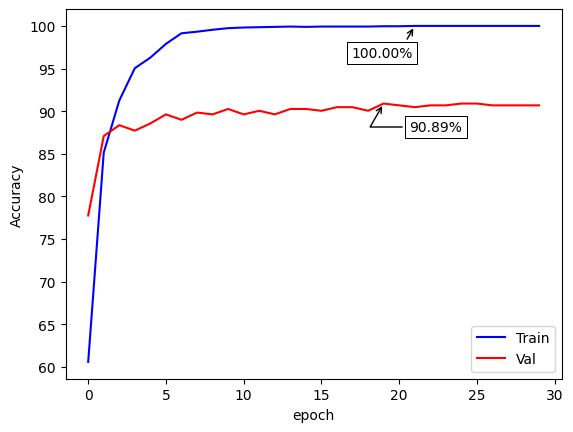

In [ ]:
plot_accuracy(BaseModel_cnn_version4_model_fit)

**Analyze Result on Test Dataset**

2/2 [==============================] - 15s 14s/step

Test Accuracy: 86.04%

2/2 [==============================] - 2s 1s/step


<Figure size 800x500 with 0 Axes>

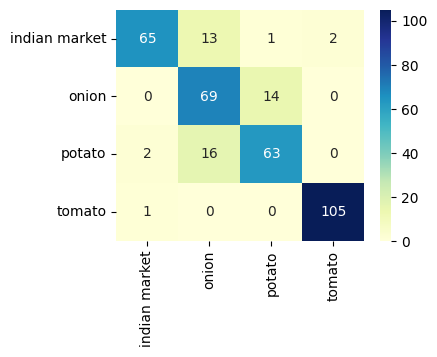

In [ ]:
model_toTest=BaseModel_cnn_version4(224,224)
print_accuracy_stats(model_toTest, test_ds,root_dir+"/base_ver4_VGG_chkpnt/checkpoint")
plot_confusion_matrix(model_toTest, test_ds,root_dir+"/base_ver4_VGG_chkpnt/checkpoint",['indian market','onion','potato','tomato'])

**Observation:**

If we look at the number of parameters, **it has 144M parameters and which takes aprox 500 Mb to store.**It is the major drawback of this network

Majority of the parameters are coming from last 3 FC layers at the last (with 120 million params)

And Convolutional part only has 20 million weights

Conv are more imp. than FC layers, as they capture the feature from the image

**RES Net:**

Why this network is important?
This Network is important for three reasons:

1) **Model architecture is tiny compared to VGGNet and googleNet**.

The authors are able to obtain such a dramatic drop in network architecture size (while still increasing the depth of the overall network) by removing fully-connected layers and instead using **global average pooling**.

2) **No more vanishing gradients problem**

We have seen only **sequential neural networks** where the output of one network feeds directly into the next.
RESNET has micro-architectures, small building blocks that are used inside the rest of the architecture,
where the output from one layer can split into a number of various paths and be rejoined later.
This is called Inception module(GoogleNet) to the deep learning community, a building block that fits into a Convolutional Neural Network enabling it to learn CONV layers with multiple filter sizes,
turning the module into a multi-level feature extractor.

but this **inception block creates more vanishing gradients.**

RES Net solves issue with VGGNet and GoogleNet by concept called **Skip Connection.**
with skip connections, resnets can have upto 250+ layers
without having any vanishing/exploding gradient problem.

In [ ]:
BaseModel_cnn_version4_model_ResNet50 = BaseModel_cnn_version4(224,224,'ResNet50')
BaseModel_cnn_version4_model_ResNet50.summary()

Model: "Baseline_with_ResNet50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 2048)              23587712  
                                                                 
 flatten_5 (Flatten)         (None, 2048)              0         
                                                                 
 dense_5 (Dense)             (None, 4)                 8196      
                                                                 
Total params: 23,595,908
Trainable params: 8,196
Non-trainable params: 23,587,712
_________________________________________________________________


In [ ]:
BaseModel_cnn_version4_model_fit_resnet = compile_train_BaseModel_cnn_version4(BaseModel_cnn_version4_model_ResNet50, train_ds_Aug, val_ds,root_dir+"/base_ver4_ResNet50_chkpnt/checkpoint",root_dir+"/base_ver4_ResNet50_chkpnt",30)

Epoch 1/30
11/11 [==============================] - 57s 3s/step - loss: 1.6380 - accuracy: 0.2846 - val_loss: 1.4977 - val_accuracy: 0.3284 - lr: 0.0010
Epoch 2/30
11/11 [==============================] - 22s 1s/step - loss: 1.3769 - accuracy: 0.3252 - val_loss: 1.2747 - val_accuracy: 0.4004 - lr: 0.0010
Epoch 3/30
11/11 [==============================] - 21s 1s/step - loss: 1.2839 - accuracy: 0.3718 - val_loss: 1.2070 - val_accuracy: 0.4809 - lr: 0.0010
Epoch 4/30
11/11 [==============================] - 22s 1s/step - loss: 1.2369 - accuracy: 0.4270 - val_loss: 1.1567 - val_accuracy: 0.4831 - lr: 0.0010
Epoch 5/30
11/11 [==============================] - 22s 1s/step - loss: 1.1877 - accuracy: 0.4514 - val_loss: 1.1256 - val_accuracy: 0.5064 - lr: 0.0010
Epoch 6/30
11/11 [==============================] - 22s 1s/step - loss: 1.1446 - accuracy: 0.5009 - val_loss: 1.1124 - val_accuracy: 0.5487 - lr: 0.0010
Epoch 7/30
11/11 [==============================] - 21s 1s/step - loss: 1.1161 - a

**Plot Train and Validation Accuracy**

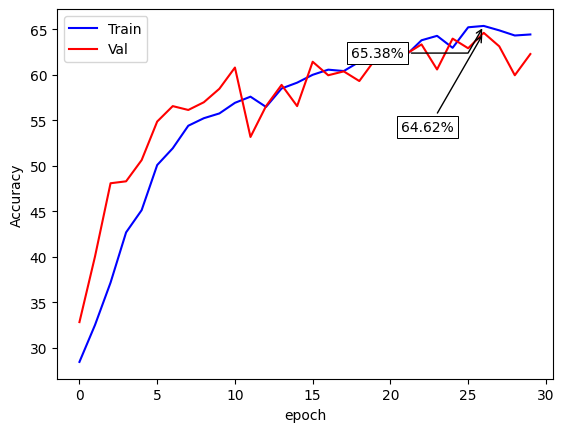

In [ ]:
plot_accuracy(BaseModel_cnn_version4_model_fit_resnet)

**Analyze Result on Test Dataset**

2/2 [==============================] - 6s 4s/step

Test Accuracy: 50.43%

2/2 [==============================] - 2s 782ms/step


<Figure size 800x500 with 0 Axes>

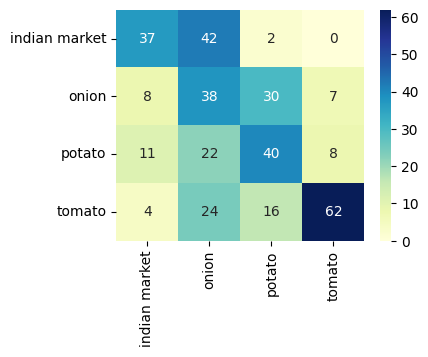

In [ ]:
model_toTest=BaseModel_cnn_version4(224,224,'ResNet50')
print_accuracy_stats(model_toTest, test_ds,root_dir+"/base_ver4_ResNet50_chkpnt/checkpoint")
plot_confusion_matrix(model_toTest, test_ds,root_dir+"/base_ver4_ResNet50_chkpnt/checkpoint",['indian market','onion','potato','tomato'])

**ResNet Architecture without Augmented data as training input**

In [ ]:
BaseModel_cnn_version4_model_fit_resnet_withoutAugmentation = compile_train_BaseModel_cnn_version4(BaseModel_cnn_version4_model_ResNet50, train_ds, val_ds,root_dir+"/base_ver4_ResNet50_chkpnt/checkpoint",root_dir+"/base_ver4_ResNet50_chkpnt",30)

Epoch 1/30
11/11 [==============================] - 26s 1s/step - loss: 0.8777 - accuracy: 0.6425 - val_loss: 0.8816 - val_accuracy: 0.6504 - lr: 0.0010
Epoch 2/30
11/11 [==============================] - 19s 1s/step - loss: 0.8250 - accuracy: 0.6737 - val_loss: 0.8857 - val_accuracy: 0.6377 - lr: 0.0010
Epoch 3/30
11/11 [==============================] - 23s 1s/step - loss: 0.8110 - accuracy: 0.6834 - val_loss: 0.8802 - val_accuracy: 0.6462 - lr: 0.0010
Epoch 4/30
11/11 [==============================] - 21s 1s/step - loss: 0.7980 - accuracy: 0.6864 - val_loss: 0.8684 - val_accuracy: 0.6653 - lr: 0.0010
Epoch 5/30
11/11 [==============================] - 21s 1s/step - loss: 0.7830 - accuracy: 0.6936 - val_loss: 0.8569 - val_accuracy: 0.6843 - lr: 0.0010
Epoch 6/30
11/11 [==============================] - 20s 1s/step - loss: 0.7728 - accuracy: 0.7007 - val_loss: 0.8627 - val_accuracy: 0.6801 - lr: 0.0010
Epoch 7/30
11/11 [==============================] - 21s 1s/step - loss: 0.7700 - a

**Plot Train and Validation Accuracy**

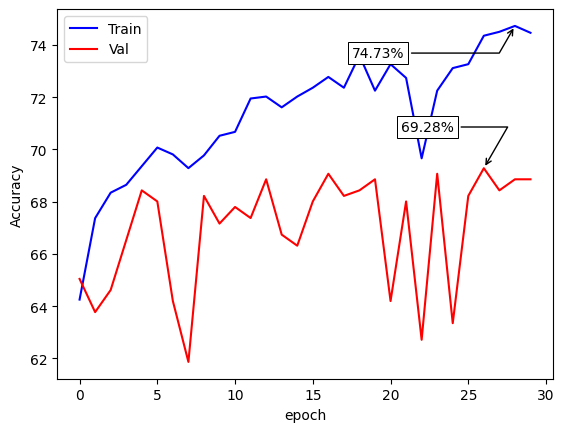

In [ ]:
plot_accuracy(BaseModel_cnn_version4_model_fit_resnet_withoutAugmentation)

**Analyze Result on Test Dataset**

2/2 [==============================] - 2s 685ms/step

Test Accuracy: 54.70%

2/2 [==============================] - 2s 961ms/step


<Figure size 800x500 with 0 Axes>

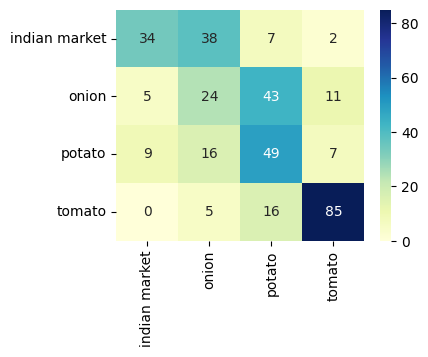

In [ ]:
model_toTest=BaseModel_cnn_version4(224,224,'ResNet50')
print_accuracy_stats(model_toTest, test_ds,root_dir+"/base_ver4_ResNet50_chkpnt/checkpoint")
plot_confusion_matrix(model_toTest, test_ds,root_dir+"/base_ver4_ResNet50_chkpnt/checkpoint",['indian market','onion','potato','tomato'])

**Observation:**

**Accuracies dropped so much** because of RESNet usage as we are **skipping few connections** which is not helping in our case.

Tried Augmented data training as well, which didnt help much in terms of accuracies.

We need to try more accurate model.

**MobileNet Architecture:**

* MobileNet achieves sky high accuracies and is 100x smaller compared to these models
* MobileNet is used on mobile apps for object detection, image classficiation, etc. and provide low latency outputs for any use case

MobileNet core is backed by Depthwise and Pointwise Convolutions which are computationally efficient yet produce significant results.




In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
BaseModel_cnn_version4_model_MobileNetV2 = BaseModel_cnn_version4(224,224,'MobileNetV2')
BaseModel_cnn_version4_model_MobileNetV2.summary()

9406464/9406464 [==============================] - 0s 0us/step
Model: "Baseline_with_MobileNetV2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 mobilenetv2_1.00_224 (Funct  (None, 7, 7, 1280)       2257984   
 ional)                                                          
                                                                 
 flatten_1 (Flatten)         (None, 62720)             0         
                                                                 
 dense_1 (Dense)             (None, 4)                 250884    
                                                                 
Total params: 2,508,868
Trainable params: 250,884
Non-trainable params: 2,257,984
_________________________________________________________________


In [ ]:
BaseModel_cnn_version4_model_fit_mobilenet = compile_train_BaseModel_cnn_version4(BaseModel_cnn_version4_model_MobileNetV2, train_ds, val_ds,root_dir+"/base_ver4_mobilenet_chkpnt/checkpoint",root_dir+"/base_ver4_mobilenet_chkpnt",30)

Epoch 1/30
11/11 [==============================] - 23s 1s/step - loss: 0.1189 - accuracy: 0.9812 - val_loss: 0.6804 - val_accuracy: 0.9449 - lr: 0.0010
Epoch 2/30
11/11 [==============================] - 16s 634ms/step - loss: 0.0545 - accuracy: 0.9929 - val_loss: 0.2965 - val_accuracy: 0.9725 - lr: 0.0010
Epoch 3/30
11/11 [==============================] - 16s 691ms/step - loss: 0.0076 - accuracy: 0.9981 - val_loss: 0.3604 - val_accuracy: 0.9682 - lr: 0.0010
Epoch 4/30
11/11 [==============================] - 16s 607ms/step - loss: 0.0056 - accuracy: 0.9985 - val_loss: 0.3314 - val_accuracy: 0.9746 - lr: 0.0010
Epoch 5/30
11/11 [==============================] - 18s 996ms/step - loss: 0.0051 - accuracy: 0.9992 - val_loss: 0.2223 - val_accuracy: 0.9788 - lr: 0.0010
Epoch 6/30
11/11 [==============================] - 16s 718ms/step - loss: 0.0040 - accuracy: 0.9989 - val_loss: 0.2261 - val_accuracy: 0.9809 - lr: 0.0010
Epoch 7/30
11/11 [==============================] - 18s 897ms/step 

**Plot Train and Validation Accuracy**

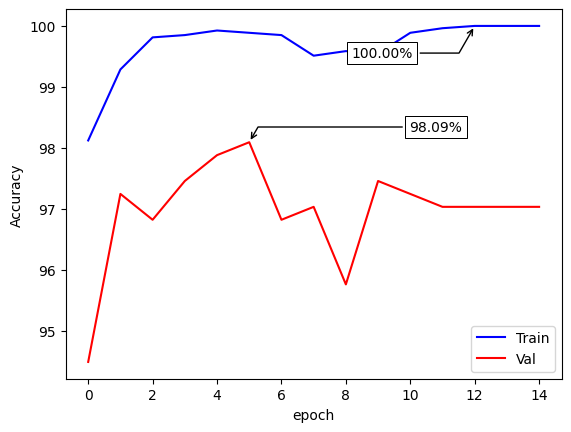

In [ ]:
plot_accuracy(BaseModel_cnn_version4_model_fit_mobilenet)

**Analyze Result on Test Dataset**

2/2 [==============================] - 2s 571ms/step

Test Accuracy: 92.59%

2/2 [==============================] - 1s 586ms/step


<Figure size 800x500 with 0 Axes>

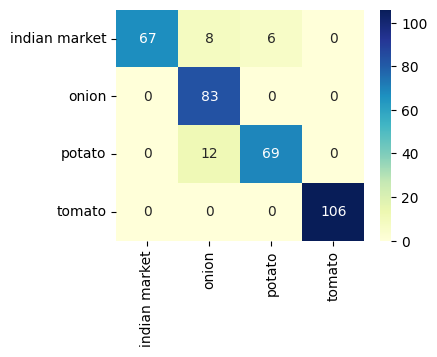

In [ ]:
model_toTest=BaseModel_cnn_version4(224,224,'MobileNetV2')
print_accuracy_stats(model_toTest, test_ds,root_dir+"/base_ver4_mobilenet_chkpnt/checkpoint")
plot_confusion_matrix(model_toTest, test_ds,root_dir+"/base_ver4_mobilenet_chkpnt/checkpoint",['indian market','onion','potato','tomato'])

Mobilenet architecture helped us to achieve nonoverfitted model with t**est accuracy of 93%.**

**Various techniques helped us to achieve this but it is greatly halted due to lack of customized large data set in this specific casestudy.**

# Section 9: Random Image testing

In [ ]:
model_ForrandomTest=BaseModel_cnn_version4(224,224,'MobileNetV2')

In [ ]:
import matplotlib.image as mpimg

In [ ]:
def prepareAndpreprocessDataFromFolder(folderpath,targetimage_width,targetimage_height):
  tf.random.set_seed(10)
  np.random.seed(10)
  rawdata = tf.keras.utils.image_dataset_from_directory(folderpath,shuffle =False, seed=123,image_size=(targetimage_width, targetimage_height))
  
  data_preprocess = tf.keras.Sequential(
      name="data_preprocess",
      layers=[ layers.Rescaling(1.0/255),]
  )

  # Perform Data Processing on the dataset
  ds = rawdata.map(lambda x, y: (data_preprocess(x), y))
  return ds

In [ ]:
Randomdata_ds=prepareAndpreprocessDataFromFolder(root_dir+"/Randomdata/",224,224)

Found 6 files belonging to 4 classes.


In [ ]:
def plot_imagesWithPredictionAndgroundTruth_Stats(model, ds,chkpnt_path):
    plt.figure(figsize=(8,5))
    model.load_weights(chkpnt_path)
    true_categories = tf.concat([y for x, y in ds], axis=0)
    allimages=tf.concat([x for x, y in ds], axis=0)
    y_pred = model.predict(ds)
    predicted_categories = tf.argmax(y_pred, axis=1)
    test_acc = metrics.accuracy_score(true_categories, predicted_categories) * 100
    print(f'\nTest Accuracy: {test_acc:.2f}%\n')
    dataSetlen=len(allimages)
    ncols=4
    nrows=int(dataSetlen/ncols)+1

    for i in range(len(allimages)):
      #ax = plt.subplot(nrows, ncols, i%ncols)
      plt.imshow(allimages[i])
      plt.title("GroundTruth-"+classes_dir[true_categories[i]]+"   Pred-"+classes_dir[predicted_categories[i]])
      plt.show()

1/1 [==============================] - 2s 2s/step

Test Accuracy: 50.00%



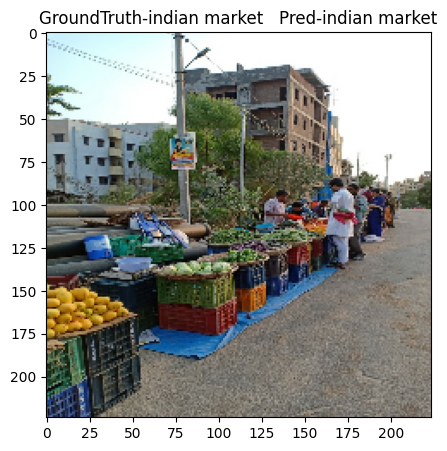

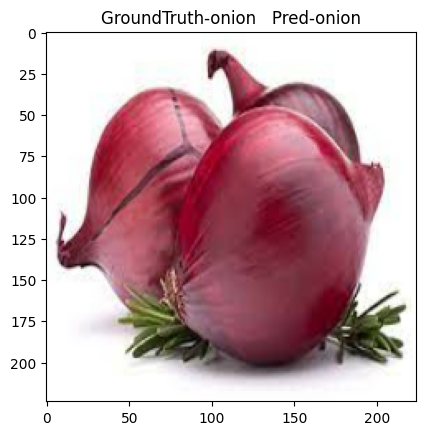

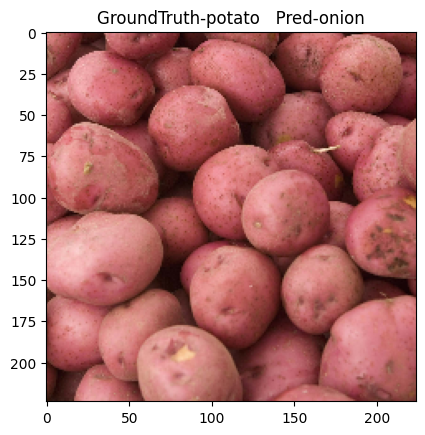

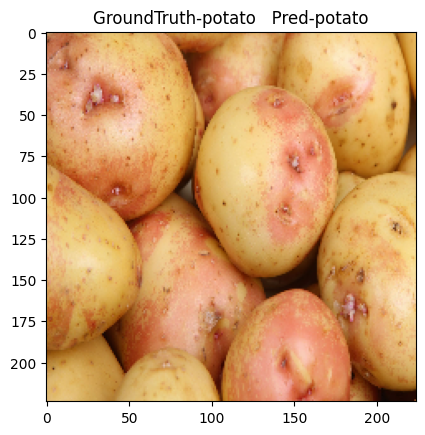

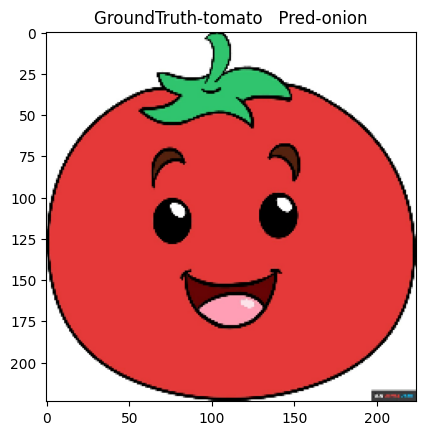

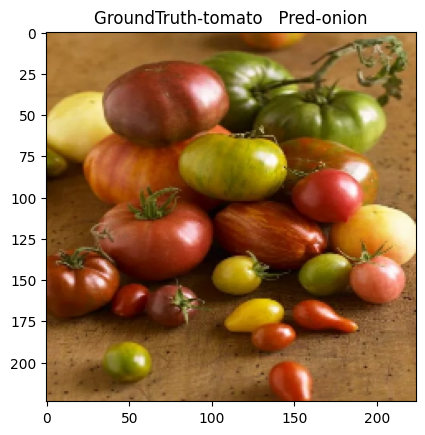

In [ ]:
plot_imagesWithPredictionAndgroundTruth_Stats(model_ForrandomTest,Randomdata_ds,root_dir+"/base_ver4_mobilenet_chkpnt/checkpoint")

# Section 10: Summary & Insights

1) **Basic architecture(ver1) Test accuracy - 76%** : Overfitting,underfitting both issues exist

2) **Basic architecture(ver2) Test accuracy - 84%** : Used more conv layers and flatten layer replaced by GlobalAveragePooling2D

Test accuracy improved(still less) but we had huge fluctuations in train and validation accuracies over epochs

3) **Basic architecture(ver2.1) Test accuracy - 84.62%** : Used callbacks and more epochs

test accuracy is slighly better than version 2.0 but fluctuations improvement is not significant

4) **Basic architecture(ver3) Test accuracy - 85.19%** : Used L2 regularization,dropout and batch normalization

Test accuracy is slighly better than version 2.1.
Fluctuations reduced a lot in training accuracies. 
Optimization improved,Validation data converged faster

5) **Basic architecture(ver3.1) Test accuracy - 84.62%**: Used DataAugmentation as preprocessing

Data Augmentation didnt helped much in test accuracy.So moved to use transfer learning with pretrained models

6) **Basic architecture(ver4) Test accuracy - 86%** : Used VGG Net

Test accuracy remained same but overfitting issue increased as we have added complex architecture.

7) **Basic architecture(ver4) Test accuracy - 50%** : Used Res Net with Augmented data

Overfitting problem recurred with lowered test accuracy.

Augmentation created issue by losing good features as we have very less dataset.

ResNet skip connections results in lowered accuracy for 30 epochs, we need to train more

8) **Basic architecture(ver4) Test accuracy - 55%** : Used Res Net with Non Augmented data

Removal of augmentation helped in test accuracy improvement slightly.

Overfitting problem recurred with lowered test accuracy.

ResNet skip connections results in lowered accuracy for 30 epochs, we need to train more/look for more accurate model.

9) **Basic architecture(ver4) Test accuracy - 93%** : Used mobile Net with Non Augmented data

MobileNet along with other regularization techniques solved overfitting issue.

Best test accuracy is achieved with in 15 epochs of training.

**Conclusion:** customized dataset will definitely have final say in test accuracy, may be with good amount of data, we can see improved test accuracy. 


